## Importing required libraries

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.stats as stats
import plotly.express as px
import plotly.graph_objects as go
import math
import warnings
warnings.filterwarnings("ignore")

## Loading the dataset

In [4]:
df=pd.read_excel("Data Science - Intern Finals - Data Set.xlsx") 
df.sample(5)

,uniqueid,ts,lat,lng,external_bat_voltage,internal_bat_voltage,engineload,tanklevel,throttle,coolant,...,live_location,to_be_expired_at,status,event_id,particulated_trap_inlet_pressure,boost_pressure,intake_manifold_1_temperature,air_inlet_pressure,exhaust_gas_temperature,adblue_level
11894,it_220403501,1712332864,18.893658,79.147308,NaN,NaN,0,NaN,NaN,89,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,68.8
11806,it_220403501,1712326913,19.023373,79.481750,NaN,NaN,80,NaN,NaN,88,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,68.8
18028,it_220403501,1713566874,18.887419,79.029396,NaN,NaN,10,NaN,NaN,83,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,68.8
18320,it_220403501,1713626538,18.907267,79.444260,NaN,NaN,67,NaN,NaN,89,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,68.8
10581,it_220403501,1712048375,18.837149,78.534767,NaN,NaN,75,NaN,NaN,85,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,99.2


## Descriptive statistics

In [6]:
df.shape

(18434, 141)

In [7]:
df.dtypes

uniqueid                          object
ts                                 int64
lat                              float64
lng                              float64
external_bat_voltage             float64
                                  ...   
boost_pressure                   float64
intake_manifold_1_temperature    float64
air_inlet_pressure               float64
exhaust_gas_temperature          float64
adblue_level                     float64
Length: 141, dtype: object

In [8]:
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18434 entries, 0 to 18433
Columns: 141 entries, uniqueid to adblue_level
dtypes: float64(122), int64(13), object(6)
memory usage: 19.8+ MB
None


In [9]:
df.describe()

,ts,lat,lng,external_bat_voltage,internal_bat_voltage,engineload,tanklevel,throttle,coolant,intakeairtemp,...,live_location,to_be_expired_at,status,event_id,particulated_trap_inlet_pressure,boost_pressure,intake_manifold_1_temperature,air_inlet_pressure,exhaust_gas_temperature,adblue_level
count,1.843400e+04,18434.000000,18434.000000,0.0,0.0,18434.000000,0.0,0.0,18434.000000,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,14770.000000
mean,1.711641e+09,18.724254,78.865351,NaN,NaN,38.141206,NaN,NaN,84.571336,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.795315
std,1.275937e+06,0.816184,3.208032,NaN,NaN,29.889358,NaN,NaN,7.718346,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,15.571199
min,1.709341e+09,0.000000,0.000000,NaN,NaN,0.000000,NaN,NaN,30.000000,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,44.400000
25%,1.710903e+09,18.701308,78.758909,NaN,NaN,10.000000,NaN,NaN,83.000000,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,68.800000
50%,1.711692e+09,18.853032,79.092408,NaN,NaN,31.000000,NaN,NaN,85.000000,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,88.400000
75%,1.712682e+09,18.921385,79.352821,NaN,NaN,64.000000,NaN,NaN,89.000000,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,99.200000
max,1.713636e+09,19.069500,79.481804,NaN,NaN,100.000000,NaN,NaN,98.000000,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,100.000000


## Data overview before cleaning

In [11]:
# Visualisation of the dataset
from skimpy import skim
skim(df)

╭──────────────────────────────────────────────── skimpy summary ─────────────────────────────────────────────────╮
│          Data Summary                Data Types                                                                 │
│ ┏━━━━━━━━━━━━━━━━━━━┳━━━━━━━━┓ ┏━━━━━━━━━━━━━┳━━━━━━━┓                                                          │
│ ┃ dataframe         ┃ Values ┃ ┃ Column Type ┃ Count ┃                                                          │
│ ┡━━━━━━━━━━━━━━━━━━━╇━━━━━━━━┩ ┡━━━━━━━━━━━━━╇━━━━━━━┩                                                          │
│ │ Number of rows    │ 18434  │ │ float64     │ 122   │                                                          │
│ │ Number of columns │ 141    │ │ int64       │ 13    │                                                          │
│ └───────────────────┴────────┘ │ string      │ 6     │                                                          │
│                                └─────────────┴───────┘                                                          │
│                                                     number                                                      │
│ ┏━━━━━━━━━━┳━━━━━━━┳━━━━━━━┳━━━━━━━━━┳━━━━━━━━━━┳━━━━━━━━━┳━━━━━━━━━━┳━━━━━━━━━┳━━━━━━━━━━┳━━━━━━━━━┳━━━━━━━━┓  │
│ ┃ column_n ┃       ┃       ┃         ┃          ┃         ┃          ┃         ┃          ┃         ┃        ┃  │
│ ┃ ame      ┃ NA    ┃ NA %  ┃ mean    ┃ sd       ┃ p0      ┃ p25      ┃ p50     ┃ p75      ┃ p100    ┃ hist   ┃  │
│ ┡━━━━━━━━━━╇━━━━━━━╇━━━━━━━╇━━━━━━━━━╇━━━━━━━━━━╇━━━━━━━━━╇━━━━━━━━━━╇━━━━━━━━━╇━━━━━━━━━━╇━━━━━━━━━╇━━━━━━━━┩  │
│ │ ts       │     0 │     0 │ 1712000 │  1276000 │ 1709000 │ 17110000 │ 1712000 │ 17130000 │ 1714000 │ ▇▁▇▇▅▇ │  │
│ │          │       │       │     000 │          │     000 │       00 │     000 │       00 │     000 │        │  │
│ │ lat      │     0 │     0 │   18.72 │   0.8162 │       0 │     18.7 │   18.85 │    18.92 │   19.07 │      ▇ │  │
│ │ lng      │     0 │     0 │   78.87 │    3.208 │       0 │    78.76 │   79.09 │    79.35 │   79.48 │      ▇ │  │
│ │ external │ 18434 │   100 │     nan │      nan │     nan │      nan │     nan │      nan │     nan │        │  │
│ │ _bat_vol │       │       │         │          │         │          │         │          │         │        │  │
│ │ tage     │       │       │         │          │         │          │         │          │         │        │  │
│ │ internal │ 18434 │   100 │     nan │      nan │     nan │      nan │     nan │      nan │     nan │        │  │
│ │ _bat_vol │       │       │         │          │         │          │         │          │         │        │  │
│ │ tage     │       │       │         │          │         │          │         │          │         │        │  │
│ │ enginelo │     0 │     0 │   38.14 │    29.89 │       0 │       10 │      31 │       64 │     100 │ ▇▅▃▃▅▂ │  │
│ │ ad       │       │       │         │          │         │          │         │          │         │        │  │
│ │ tankleve │ 18434 │   100 │     nan │      nan │     nan │      nan │     nan │      nan │     nan │        │  │
│ │ l        │       │       │         │          │         │          │         │          │         │        │  │
│ │ throttle │ 18434 │   100 │     nan │      nan │     nan │      nan │     nan │      nan │     nan │        │  │
│ │ coolant  │     0 │     0 │   84.57 │    7.718 │      30 │       83 │      85 │       89 │      98 │     ▇▅ │  │
│ │ intakeai │ 18434 │   100 │     nan │      nan │     nan │      nan │     nan │      nan │     nan │        │  │
│ │ rtemp    │       │       │         │          │         │          │         │          │         │        │  │
│ │ engineoi │     0 │     0 │    1775 │ 6.105e-1 │    1775 │     1775 │    1775 │     1775 │    1775 │     ▇  │  │
│ │ ltemp    │       │       │         │          │         │          │         │          │         │        │  │
│ │ imap     │ 18434 │   100 │     nan │      nan │     

## Handling null columns (Columns containing only null values)

In [13]:
# Calculation of percentage of missing values in every column of the dataset
df.isnull().mean()

uniqueid                         0.000000
ts                               0.000000
lat                              0.000000
lng                              0.000000
external_bat_voltage             1.000000
                                   ...   
boost_pressure                   1.000000
intake_manifold_1_temperature    1.000000
air_inlet_pressure               1.000000
exhaust_gas_temperature          1.000000
adblue_level                     0.198763
Length: 141, dtype: float64

In [14]:
#Creation of a dictionary to store column names as keys and percentage of null values as values
null_means_dict = df.isnull().mean().to_dict()

In [15]:
#Creation of a dictionary to store columns which have 100% null values
filtered_keys = [key for key, value in null_means_dict.items() if value == 1]
print(filtered_keys)
print()
print(len(filtered_keys))

['external_bat_voltage', 'internal_bat_voltage', 'tanklevel', 'throttle', 'intakeairtemp', 'imap', 'warmups', 'maf', 'fuelrail', 'mil', 'obdstandards', 'telltale', 'pto_drive_engagement', 'service_distance', 'gross_combination_vehicle_weight', 'vehicle_weight', 'air_suspension_pressure_front_axle_left', 'air_suspension_pressure_front_axle_right', 'air_suspension_pressure_rear_axle_left', 'air_suspension_pressure_rear_axle_right', 'state_of_charge', 'battery_pack_voltage', 'battery_pack_current', 'power', 'lamp_status', 'hydraulic_oil_filter', 'air_filter', 'no_charging', 'low_fuel', 'engine_temp_high', 'hydraulic_oil_temp_high', 'water_in_fuel', 'low_oil_pressure', 'roller_speed', 'axle_position', 'tire_position', 'tire_pressure', 'tire_temperature', 'tire_air_leakage_rate', 'tire_sensor_enable_status', 'tire_status', 'tire_sensor_electric_fault', 'extended_tire_pressure_support', 'tire_pressure_threshold_detection', 'extended_tire_pressure', 'cpc_system_type', 'required_tire_pressure'

In [16]:
#Dropping of columns having 100% null values
df.drop(columns=filtered_keys, inplace=True)

In [17]:
df.columns

Index(['uniqueid', 'ts', 'lat', 'lng', 'engineload', 'coolant',
       'engineoiltemp', 'vehiclespeed', 'rpm', 'obddistance', 'runtime',
       'engine_torque_percent', 'selected_gear', 'current_gear',
       'fuel_consumption', 'fuel_level', 'fl_level', 'fuel_rate',
       'fuel_economy', 'accelerator_pedal_pos', 'pluscode', 'vibration_status',
       'can_raw_data', 'engine_throttle_valve1_pos',
       'engine_throttle_valve2_pos', 'enginefueltemp',
       'drivers_demand_engine_torque_percent', 'engine_torque_mode',
       'accelerator_pedal_pos_2', 'brake_switch_status',
       'clutch_switch_status', 'parking_switch_status', 'adblue_level'],
      dtype='object')

In [18]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18434 entries, 0 to 18433
Data columns (total 33 columns):
 #   Column                                Non-Null Count  Dtype  
---  ------                                --------------  -----  
 0   uniqueid                              18434 non-null  object 
 1   ts                                    18434 non-null  int64  
 2   lat                                   18434 non-null  float64
 3   lng                                   18434 non-null  float64
 4   engineload                            18434 non-null  int64  
 5   coolant                               18434 non-null  int64  
 6   engineoiltemp                         18434 non-null  float64
 7   vehiclespeed                          18434 non-null  float64
 8   rpm                                   18434 non-null  float64
 9   obddistance                           18434 non-null  int64  
 10  runtime                               18420 non-null  float64
 11  engine_torque_p

## Categorical and Numerical columns Identification

In [20]:
# Categorical and numerical columns identification
categorical_columns=[]
numerical_columns=[]
for e in df.columns:
    if df[e].dtypes=="O":
        categorical_columns.append(e)
    else:
        numerical_columns.append(e)
print("Categorical columns: ", categorical_columns)
print(len(categorical_columns))
print()
print("Numerical columns: ", numerical_columns)
print(len(numerical_columns))

Categorical columns:  ['uniqueid', 'pluscode', 'can_raw_data', 'brake_switch_status', 'clutch_switch_status', 'parking_switch_status']
6

Numerical columns:  ['ts', 'lat', 'lng', 'engineload', 'coolant', 'engineoiltemp', 'vehiclespeed', 'rpm', 'obddistance', 'runtime', 'engine_torque_percent', 'selected_gear', 'current_gear', 'fuel_consumption', 'fuel_level', 'fl_level', 'fuel_rate', 'fuel_economy', 'accelerator_pedal_pos', 'vibration_status', 'engine_throttle_valve1_pos', 'engine_throttle_valve2_pos', 'enginefueltemp', 'drivers_demand_engine_torque_percent', 'engine_torque_mode', 'accelerator_pedal_pos_2', 'adblue_level']
27


## Identifying and removing columns containing only 1 unique value

In [22]:
# Identifying columns with only one unique value
columns_with_one_unique_value = [col for col in df.columns if df[col].nunique() == 1]
print("Columns with only one unique value:")
print(columns_with_one_unique_value)
print(f"Original dataframe shape: {df.shape}")

Columns with only one unique value:
['uniqueid', 'engineoiltemp', 'selected_gear', 'vibration_status', 'engine_throttle_valve2_pos', 'enginefueltemp', 'accelerator_pedal_pos_2']
Original dataframe shape: (18434, 33)


In [23]:
# Removing these columns from the dataframe
df = df.drop(columns=columns_with_one_unique_value)
print(f"Updated dataframe shape: {df.shape}")

Updated dataframe shape: (18434, 26)


In [24]:
categorical_columns=[]
numerical_columns=[]
for e in df.columns:
    if df[e].dtypes=="O":
        categorical_columns.append(e)
    else:
        numerical_columns.append(e)
print("Categorical columns: ", categorical_columns)
print(len(categorical_columns))
print()
print("Numerical columns: ", numerical_columns)
print(len(numerical_columns))

Categorical columns:  ['pluscode', 'can_raw_data', 'brake_switch_status', 'clutch_switch_status', 'parking_switch_status']
5

Numerical columns:  ['ts', 'lat', 'lng', 'engineload', 'coolant', 'vehiclespeed', 'rpm', 'obddistance', 'runtime', 'engine_torque_percent', 'current_gear', 'fuel_consumption', 'fuel_level', 'fl_level', 'fuel_rate', 'fuel_economy', 'accelerator_pedal_pos', 'engine_throttle_valve1_pos', 'drivers_demand_engine_torque_percent', 'engine_torque_mode', 'adblue_level']
21


## Manually checking for categorical columns, containing int or float values

In [26]:
numerical_columns.remove("engine_torque_mode")
numerical_columns.remove("lat")
numerical_columns.remove("lng")
print(numerical_columns)
print(len(numerical_columns))

['ts', 'engineload', 'coolant', 'vehiclespeed', 'rpm', 'obddistance', 'runtime', 'engine_torque_percent', 'current_gear', 'fuel_consumption', 'fuel_level', 'fl_level', 'fuel_rate', 'fuel_economy', 'accelerator_pedal_pos', 'engine_throttle_valve1_pos', 'drivers_demand_engine_torque_percent', 'adblue_level']
18


In [27]:
categorical_columns.append("engine_torque_mode")
categorical_columns

['pluscode',
 'can_raw_data',
 'brake_switch_status',
 'clutch_switch_status',
 'parking_switch_status',
 'engine_torque_mode']

## Outlier detection and removal

### Box plots

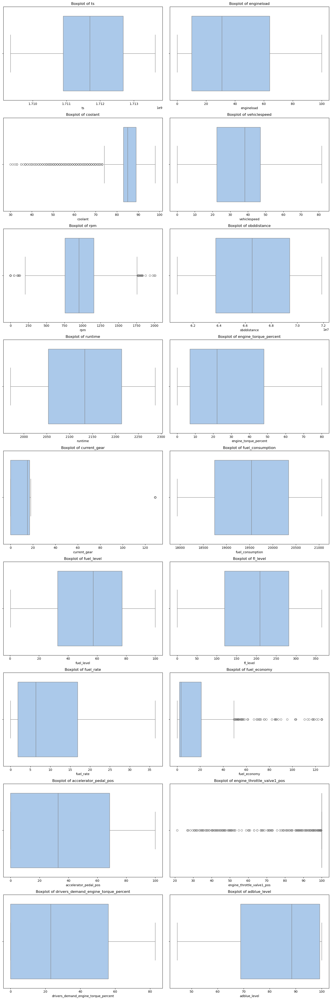

In [30]:
# Define the number of plots per row
plots_per_row = 2

# Calculate the number of rows required
num_plots = len(numerical_columns)
num_rows = math.ceil(num_plots / plots_per_row)

# Create subplots
fig, axes = plt.subplots(num_rows, plots_per_row, figsize=(15, num_rows * 5))
axes = axes.flatten()  # Flatten the axes array for easy indexing

# Iterate over numerical columns and plot
for i, col in enumerate(numerical_columns):
    #sns.boxplot(x=df[col], ax=axes[i], color=color_palette(0.6))
    sns.boxplot(x=df[col], palette="pastel", ax=axes[i])
    axes[i].set_title(f"Boxplot of {col}")
    axes[i].set_xlabel(col)

# Hide unused subplots if any
for j in range(len(numerical_columns), len(axes)):
    axes[j].axis('off')

# Adjust layout
plt.tight_layout()
plt.show()

### IQR Method for outlier detection and removal

In [32]:
# Detect outliers using IQR

# Iterating over all columns and finding the Q1 and Q3 values
for col in numerical_columns:
    Q1 = df[col].quantile(0.25)
    Q3 = df[col].quantile(0.75)

# Calculation of IQR
    IQR = Q3 - Q1

# Outlier detection
    outliers = df[(df[col] < (Q1 - 1.5 * IQR)) | (df[col] > (Q3 + 1.5 * IQR))]
    print(f"Outliers in {col}: {len(outliers)}")

Outliers in ts: 0
Outliers in engineload: 0
Outliers in coolant: 1084
Outliers in vehiclespeed: 0
Outliers in rpm: 1161
Outliers in obddistance: 0
Outliers in runtime: 0
Outliers in engine_torque_percent: 0
Outliers in current_gear: 474
Outliers in fuel_consumption: 0
Outliers in fuel_level: 0
Outliers in fl_level: 0
Outliers in fuel_rate: 0
Outliers in fuel_economy: 2837
Outliers in accelerator_pedal_pos: 0
Outliers in engine_throttle_valve1_pos: 1485
Outliers in drivers_demand_engine_torque_percent: 0
Outliers in adblue_level: 0


In [33]:
outlier_columns=["coolant", "current_gear", "fuel_economy"]

In [34]:
# Remove outliers using IQR and Winsorization
for e in outlier_columns:
    q1=np.quantile(df[e],0.25)
    q3=np.quantile(df[e],0.75)
    iqr=q3-q1
    lb=q1-1.5*iqr
    ub=q3+1.5*iqr
    df[e]=np.where(df[e]<lb,lb,df[e])
    df[e]=np.where(df[e]>ub,ub,df[e])

In [35]:
# Detect outliers using IQR
for col in outlier_columns:
    Q1 = df[col].quantile(0.25)
    Q3 = df[col].quantile(0.75)
    IQR = Q3 - Q1
    outliers = df[(df[col] < (Q1 - 1.5 * IQR)) | (df[col] > (Q3 + 1.5 * IQR))]
    print(f"Outliers in {col}: {len(outliers)}")

Outliers in coolant: 0
Outliers in current_gear: 0
Outliers in fuel_economy: 0


## Handling missing values

In [37]:
# No. of missing values in every column
df.isnull().sum()

ts                                         0
lat                                        0
lng                                        0
engineload                                 0
coolant                                    0
vehiclespeed                               0
rpm                                        0
obddistance                                0
runtime                                   14
engine_torque_percent                      0
current_gear                               0
fuel_consumption                           0
fuel_level                                 2
fl_level                                   0
fuel_rate                                  0
fuel_economy                               0
accelerator_pedal_pos                      0
pluscode                                   0
can_raw_data                               0
engine_throttle_valve1_pos                 0
drivers_demand_engine_torque_percent       0
engine_torque_mode                         0
brake_swit

In [38]:
# Percentage of missing values in every column
df.isnull().mean()

ts                                      0.000000
lat                                     0.000000
lng                                     0.000000
engineload                              0.000000
coolant                                 0.000000
vehiclespeed                            0.000000
rpm                                     0.000000
obddistance                             0.000000
runtime                                 0.000759
engine_torque_percent                   0.000000
current_gear                            0.000000
fuel_consumption                        0.000000
fuel_level                              0.000108
fl_level                                0.000000
fuel_rate                               0.000000
fuel_economy                            0.000000
accelerator_pedal_pos                   0.000000
pluscode                                0.000000
can_raw_data                            0.000000
engine_throttle_valve1_pos              0.000000
drivers_demand_engin

### KNN imputation for missing values

In [40]:
from sklearn.impute import KNNImputer

#Selecting only the numerical columns
numerical_data = df[numerical_columns[1:]]

#Initializing the KNN Imputer
knn_imputer = KNNImputer(n_neighbors=5)  # You can adjust n_neighbors as needed

#Performing KNN imputation
imputed_data = knn_imputer.fit_transform(numerical_data)

# Step 4: Replace the original numerical columns with imputed data
df[numerical_columns[1:]] = imputed_data

df.head()

,ts,lat,lng,engineload,coolant,vehiclespeed,rpm,obddistance,runtime,engine_torque_percent,...,accelerator_pedal_pos,pluscode,can_raw_data,engine_throttle_valve1_pos,drivers_demand_engine_torque_percent,engine_torque_mode,brake_switch_status,clutch_switch_status,parking_switch_status,adblue_level
0,1709340731,19.069340,78.355148,28.0,74.0,0.00000,749.000,60780800.0,1970.85,21.0,...,0.0,7JFW3994+,"0CF00300:D1001CFFFF4C4886,0CF00400:407D9268170...",100.0,0.0,1,Released,Released,Pressed,52.4
1,1709340794,19.069347,78.355141,22.0,74.0,0.00000,1208.375,60780800.0,1970.85,18.0,...,23.6,7JFW3994+,"0CF00300:D03B16FFFF4C4283,0CF00400:41908FC3250...",99.6,19.0,2,Released,Pressed,Pressed,52.4
2,1709340857,19.069414,78.355179,25.0,74.0,1.40625,752.625,60780800.0,1970.85,18.0,...,0.0,7JFW3994+,"0CF00300:D10019FFFF4C4983,0CF00400:307D8F85170...",99.6,0.0,1,Pressed,Pressed,Released,52.4
3,1709340920,19.069258,78.355225,35.0,74.0,2.81250,996.375,60780820.0,1970.90,27.0,...,33.6,7JFW3994+,"0CF00300:D05423FFFF4C4C82,0CF00400:519998231F0...",99.6,28.0,2,Released,Pressed,Released,52.4
4,1709340983,19.069094,78.355339,0.0,74.0,4.53125,1065.750,60780840.0,1970.90,1.0,...,3.2,7JFW3994+,"0CF00300:D10800FFFF4C3284,0CF00400:017E7E4E210...",100.0,1.0,2,Released,Pressed,Released,52.4


In [41]:
df.isnull().sum()

ts                                      0
lat                                     0
lng                                     0
engineload                              0
coolant                                 0
vehiclespeed                            0
rpm                                     0
obddistance                             0
runtime                                 0
engine_torque_percent                   0
current_gear                            0
fuel_consumption                        0
fuel_level                              0
fl_level                                0
fuel_rate                               0
fuel_economy                            0
accelerator_pedal_pos                   0
pluscode                                0
can_raw_data                            0
engine_throttle_valve1_pos              0
drivers_demand_engine_torque_percent    0
engine_torque_mode                      0
brake_switch_status                     0
clutch_switch_status              

## Feature construction

In [43]:
df['speed_to_rpm_ratio'] = df['vehiclespeed'] / (df['rpm'] + 1)  # Evaluates engine efficiency in converting RPM to speed.
df['fuel_efficiency_score'] = df['fuel_rate'] / (df['fuel_economy'] + 1)  # Measures how effectively fuel is used during operation.
df['throttle_efficiency'] = df['engineload'] / (df['accelerator_pedal_pos'] + 1)  # Captures driver input's effect on engine load.

df['runtime_hours'] = df['runtime'] / 3600  # Converts runtime from seconds to hours for time-based analysis.

df['is_accelerating'] = (df['accelerator_pedal_pos'].diff().fillna(0) > 0).astype(int)  # Identifies when the vehicle is accelerating.


df['is_stationary'] = ((df['lat'].diff().fillna(0) == 0) & (df['lng'].diff().fillna(0) == 0)).astype(int)  # Flags stationary states.
df['region_code'] = df['pluscode'].str[:4]  # Groups vehicles by geographic region for location-based analysis.


df['low_adblue_alert'] = (df['adblue_level'] < 10).astype(int)  # Flags vehicles with AdBlue levels below the threshold.


df['efficiency_score'] = df['vehiclespeed'] * df['fuel_economy'] / (df['engineload'] + 1)  # Measures the overall operational efficiency.


df['aggressive_acceleration'] = (df['accelerator_pedal_pos'].diff().fillna(0).abs() > 30).astype(int)  # Flags aggressive acceleration events.
df['stop_frequency'] = (df['vehiclespeed'] == 0).cumsum()  # Tracks the number of stops made by the vehicle.

df['distance_covered'] = df['obddistance'].diff().fillna(0)  # Calculates the distance traveled between consecutive points.
df['rpm_to_load_ratio'] = df['rpm'] / (df['engineload'] + 1)  # Evaluates engine stress during operation.


df['fuel_consumption_per_hour'] = df['fuel_rate'] * (df['runtime'] / 3600)  # Calculates total fuel consumption per hour.
df['fuel_performance_ratio'] = df['fuel_economy'] / (df['vehiclespeed'] + df['engineload'] + 1)  # Assesses fuel performance relative to operational factors.


df[['speed_to_rpm_ratio', 'fuel_efficiency_score', 'throttle_efficiency', 'runtime_hours', 'is_accelerating',
    'region_code', 'is_stationary', 'low_adblue_alert', 'efficiency_score', 'aggressive_acceleration', 'stop_frequency', 
    'distance_covered', 'rpm_to_load_ratio', 'fuel_consumption_per_hour', 'fuel_performance_ratio']].head()


,speed_to_rpm_ratio,fuel_efficiency_score,throttle_efficiency,runtime_hours,is_accelerating,region_code,is_stationary,low_adblue_alert,efficiency_score,aggressive_acceleration,stop_frequency,distance_covered,rpm_to_load_ratio,fuel_consumption_per_hour,fuel_performance_ratio
0,0.000000,5.300000,28.000000,0.547458,0,7JFW,1,0,0.000000,0,1,0.0,25.827586,2.901529,0.000000
1,0.000000,6.450000,0.894309,0.547458,1,7JFW,0,0,0.000000,0,2,0.0,52.538043,3.531106,0.000000
2,0.001866,3.512993,25.000000,0.547458,0,7JFW,0,0,0.018275,0,2,0.0,28.947115,2.573054,0.012329
3,0.002820,7.671080,1.011561,0.547472,1,7JFW,0,0,0.009460,1,2,20.0,27.677083,4.708261,0.003120
4,0.004248,0.000000,0.000000,0.547472,0,7JFW,0,0,223.686215,1,2,20.0,1065.750000,0.000000,8.924788


In [44]:
df.sample(5)

,ts,lat,lng,engineload,coolant,vehiclespeed,rpm,obddistance,runtime,engine_torque_percent,...,is_stationary,region_code,low_adblue_alert,efficiency_score,aggressive_acceleration,stop_frequency,distance_covered,rpm_to_load_ratio,fuel_consumption_per_hour,fuel_performance_ratio
18218,1713588712,19.034210,79.353981,25.0,83.0,0.000000,749.50,71779976.0,2283.40,18.0,...,0,7JFX,0,0.000000,0,2197,8.0,28.826923,2.981106,0.000000
119,1709360828,18.838148,78.504601,9.0,82.0,54.000000,750.75,60838448.0,1972.50,6.0,...,0,7JCW,0,233.022658,0,32,948.0,75.075000,0.684896,0.674255
12797,1712455419,18.882998,78.355949,0.0,83.0,64.468750,1622.75,68751104.0,2195.45,0.0,...,0,7JCW,0,3182.514908,0,1280,1328.0,1622.750000,0.000000,0.754027
12568,1712440653,18.913677,79.445755,0.0,89.0,25.953125,1266.50,68588600.0,2191.50,0.0,...,0,7JCX,0,1281.182080,0,1270,408.0,1266.500000,0.000000,1.831522
1890,1709729964,18.869354,79.020370,27.0,83.0,37.796875,960.25,61962320.0,2004.30,16.0,...,0,7JCX,0,7.129098,0,147,736.0,34.294643,4.008600,0.080266


### Handling datetime column

In [46]:
# Convert 'ts' (timestamp) to datetime
df['ts'] = pd.to_datetime(df['ts'], unit='s')
df["ts"].info()

<class 'pandas.core.series.Series'>
RangeIndex: 18434 entries, 0 to 18433
Series name: ts
Non-Null Count  Dtype         
--------------  -----         
18434 non-null  datetime64[ns]
dtypes: datetime64[ns](1)
memory usage: 144.1 KB


In [47]:
df["ts"].sample(5)

17492   2024-04-18 20:48:54
2354    2024-03-07 12:35:09
17077   2024-04-17 19:57:18
795     2024-03-04 08:25:18
3950    2024-03-11 18:28:16
Name: ts, dtype: datetime64[ns]

In [48]:
#Create new features from timestamp column like hours, minutes and seconds

df["hour"]=df["ts"].dt.hour # Calculates the hours from the ts(timestamp) column

df["min"]=df["ts"].dt.minute # Calculates the minutes from the ts(timestamp) column

df["sec"]=df["ts"].dt.second # Calculates the seconds from the ts(timestamp) column

df.head()

,ts,lat,lng,engineload,coolant,vehiclespeed,rpm,obddistance,runtime,engine_torque_percent,...,efficiency_score,aggressive_acceleration,stop_frequency,distance_covered,rpm_to_load_ratio,fuel_consumption_per_hour,fuel_performance_ratio,hour,min,sec
0,2024-03-02 00:52:11,19.069340,78.355148,28.0,74.0,0.00000,749.000,60780800.0,1970.85,21.0,...,0.000000,0,1,0.0,25.827586,2.901529,0.000000,0,52,11
1,2024-03-02 00:53:14,19.069347,78.355141,22.0,74.0,0.00000,1208.375,60780800.0,1970.85,18.0,...,0.000000,0,2,0.0,52.538043,3.531106,0.000000,0,53,14
2,2024-03-02 00:54:17,19.069414,78.355179,25.0,74.0,1.40625,752.625,60780800.0,1970.85,18.0,...,0.018275,0,2,0.0,28.947115,2.573054,0.012329,0,54,17
3,2024-03-02 00:55:20,19.069258,78.355225,35.0,74.0,2.81250,996.375,60780820.0,1970.90,27.0,...,0.009460,1,2,20.0,27.677083,4.708261,0.003120,0,55,20
4,2024-03-02 00:56:23,19.069094,78.355339,0.0,74.0,4.53125,1065.750,60780840.0,1970.90,1.0,...,223.686215,1,2,20.0,1065.750000,0.000000,8.924788,0,56,23


In [49]:
#Create new features from timestamp column like month, day and day of week
df["month"]=df["ts"].dt.month # Calculates the month from the ts(timestamp) column

df["day"]=df["ts"].dt.day # Calculates the day from the ts(timestamp) column

df["dayofweek"]=df["ts"].dt.dayofweek # Calculates the day of week from the ts(timestamp) column

df.head()

,ts,lat,lng,engineload,coolant,vehiclespeed,rpm,obddistance,runtime,engine_torque_percent,...,distance_covered,rpm_to_load_ratio,fuel_consumption_per_hour,fuel_performance_ratio,hour,min,sec,month,day,dayofweek
0,2024-03-02 00:52:11,19.069340,78.355148,28.0,74.0,0.00000,749.000,60780800.0,1970.85,21.0,...,0.0,25.827586,2.901529,0.000000,0,52,11,3,2,5
1,2024-03-02 00:53:14,19.069347,78.355141,22.0,74.0,0.00000,1208.375,60780800.0,1970.85,18.0,...,0.0,52.538043,3.531106,0.000000,0,53,14,3,2,5
2,2024-03-02 00:54:17,19.069414,78.355179,25.0,74.0,1.40625,752.625,60780800.0,1970.85,18.0,...,0.0,28.947115,2.573054,0.012329,0,54,17,3,2,5
3,2024-03-02 00:55:20,19.069258,78.355225,35.0,74.0,2.81250,996.375,60780820.0,1970.90,27.0,...,20.0,27.677083,4.708261,0.003120,0,55,20,3,2,5
4,2024-03-02 00:56:23,19.069094,78.355339,0.0,74.0,4.53125,1065.750,60780840.0,1970.90,1.0,...,20.0,1065.750000,0.000000,8.924788,0,56,23,3,2,5


In [50]:
df[["ts", "hour", "min", "sec", "month", "day", "dayofweek"]].sample(5)

,ts,hour,min,sec,month,day,dayofweek
5208,2024-03-21 09:15:52,9,15,52,3,21,3
2808,2024-03-08 04:49:13,4,49,13,3,8,4
3669,2024-03-11 11:43:06,11,43,6,3,11,0
6403,2024-03-23 01:15:08,1,15,8,3,23,5
13658,2024-04-09 12:21:31,12,21,31,4,9,1


## Data overview after cleaning

In [52]:
# Data Visualisation after data cleaning
from skimpy import skim
skim(df)

╭──────────────────────────────────────────────── skimpy summary ─────────────────────────────────────────────────╮
│          Data Summary                Data Types                                                                 │
│ ┏━━━━━━━━━━━━━━━━━━━┳━━━━━━━━┓ ┏━━━━━━━━━━━━━┳━━━━━━━┓                                                          │
│ ┃ dataframe         ┃ Values ┃ ┃ Column Type ┃ Count ┃                                                          │
│ ┡━━━━━━━━━━━━━━━━━━━╇━━━━━━━━┩ ┡━━━━━━━━━━━━━╇━━━━━━━┩                                                          │
│ │ Number of rows    │ 18434  │ │ float64     │ 28    │                                                          │
│ │ Number of columns │ 47     │ │ int64       │ 12    │                                                          │
│ └───────────────────┴────────┘ │ string      │ 6     │                                                          │
│                                │ datetime64  │ 1     │                                                          │
│                                └─────────────┴───────┘                                                          │
│                                                     number                                                      │
│ ┏━━━━━━━━━━━┳━━━━┳━━━━━━┳━━━━━━━━━━┳━━━━━━━━━┳━━━━━━━━━━┳━━━━━━━━━━┳━━━━━━━━━━┳━━━━━━━━━━┳━━━━━━━━━━┳━━━━━━━━┓  │
│ ┃ column_na ┃    ┃      ┃          ┃         ┃          ┃          ┃          ┃          ┃          ┃        ┃  │
│ ┃ me        ┃ NA ┃ NA % ┃ mean     ┃ sd      ┃ p0       ┃ p25      ┃ p50      ┃ p75      ┃ p100     ┃ hist   ┃  │
│ ┡━━━━━━━━━━━╇━━━━╇━━━━━━╇━━━━━━━━━━╇━━━━━━━━━╇━━━━━━━━━━╇━━━━━━━━━━╇━━━━━━━━━━╇━━━━━━━━━━╇━━━━━━━━━━╇━━━━━━━━┩  │
│ │ lat       │  0 │    0 │    18.72 │  0.8162 │        0 │     18.7 │    18.85 │    18.92 │    19.07 │      ▇ │  │
│ │ lng       │  0 │    0 │    78.87 │   3.208 │        0 │    78.76 │    79.09 │    79.35 │    79.48 │      ▇ │  │
│ │ engineloa │  0 │    0 │    38.14 │   29.89 │        0 │       10 │       31 │       64 │      100 │ ▇▅▃▃▅▂ │  │
│ │ d         │    │      │          │         │          │          │          │          │          │        │  │
│ │ coolant   │  0 │    0 │    85.47 │   4.599 │       74 │       83 │       85 │       89 │       98 │ ▁▁▇▅▃  │  │
│ │ vehiclesp │  0 │    0 │    33.36 │   17.93 │        0 │    22.36 │    38.19 │    47.01 │     81.7 │ ▅▃▆▇▂  │  │
│ │ eed       │    │      │          │         │          │          │          │          │          │        │  │
│ │ rpm       │  0 │    0 │      937 │     327 │        0 │    757.2 │    950.8 │     1158 │     2011 │ ▁ ▇▆▁  │  │
│ │ obddistan │  0 │    0 │ 66500000 │ 3256000 │ 60780000 │ 63730000 │ 66530000 │ 69410000 │ 71870000 │ ▆▇▆▆▇▇ │  │
│ │ ce        │    │      │          │         │          │          │          │          │          │        │  │
│ │ runtime   │  0 │    0 │     2132 │   92.46 │     1971 │     2053 │     2133 │     2214 │     2287 │ ▇▇▇▇▇▇ │  │
│ │ engine_to │  0 │    0 │    28.04 │   22.53 │        0 │        7 │       22 │       48 │       80 │ ▇▅▃▃▃▁ │  │
│ │ rque_perc │    │      │          │         │          │          │          │          │          │        │  │
│ │ ent       │    │      │          │         │          │          │          │          │          │        │  │
│ │ current_g │  0 │    0 │    11.33 │   8.749 │        0 │        0 │       15 │       17 │     42.5 │  ▅▃▇   │  │
│ │ ear       │    │      │          │         │          │          │          │          │          │        │  │
│ │ fuel_cons │  0 │    0 │    19530 │   919.1 │    17940 │    18740 │    19540 │    20340 │    21060 │ ▇▇▇▇▇▇ │  │
│ │ umption   │    │      │          │         │          │          │          │          │          │        │  │
│ │ fuel_leve │  0 │    0 │       55 │   26.77 │      0.4 │     32.8 │     57.2 │     77.2 │      100 │ ▃▆▆▇▆▇ │  │
│ │ l         │    │      │          │         │        

## Exploratory data analysis

### Normality check

In [55]:
categorical_columns=[]
numerical_columns=[]
for e in df.columns:
    if df[e].dtypes=="O":
        categorical_columns.append(e)
    else:
        numerical_columns.append(e)
print("Categorical columns: ", categorical_columns)
print(len(categorical_columns))
print()
print("Numerical columns: ", numerical_columns)
print(len(numerical_columns))

Categorical columns:  ['pluscode', 'can_raw_data', 'brake_switch_status', 'clutch_switch_status', 'parking_switch_status', 'region_code']
6

Numerical columns:  ['ts', 'lat', 'lng', 'engineload', 'coolant', 'vehiclespeed', 'rpm', 'obddistance', 'runtime', 'engine_torque_percent', 'current_gear', 'fuel_consumption', 'fuel_level', 'fl_level', 'fuel_rate', 'fuel_economy', 'accelerator_pedal_pos', 'engine_throttle_valve1_pos', 'drivers_demand_engine_torque_percent', 'engine_torque_mode', 'adblue_level', 'speed_to_rpm_ratio', 'fuel_efficiency_score', 'throttle_efficiency', 'runtime_hours', 'is_accelerating', 'is_stationary', 'low_adblue_alert', 'efficiency_score', 'aggressive_acceleration', 'stop_frequency', 'distance_covered', 'rpm_to_load_ratio', 'fuel_consumption_per_hour', 'fuel_performance_ratio', 'hour', 'min', 'sec', 'month', 'day', 'dayofweek']
41


In [56]:
numerical_columns.remove("ts")
numerical_columns.remove("lat")
numerical_columns.remove("lng")
numerical_columns.remove("engine_torque_mode")
numerical_columns.remove("is_accelerating")
numerical_columns.remove("is_stationary")
numerical_columns.remove("low_adblue_alert")
numerical_columns.remove("aggressive_acceleration")



In [57]:
categorical_columns.append("engine_torque_mode")
categorical_columns.append("is_accelerating")
categorical_columns.append("is_stationary")
categorical_columns.append("low_adblue_alert")
categorical_columns.append("aggressive_acceleration")

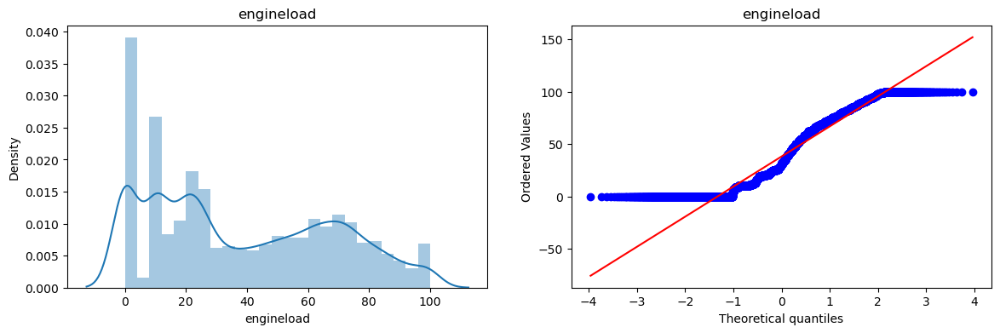

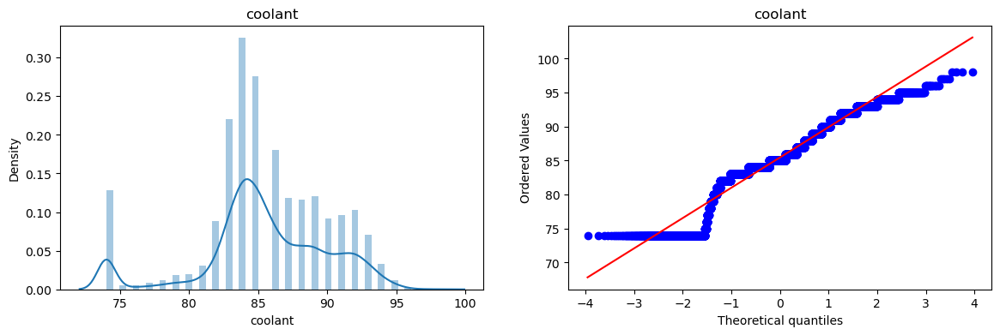

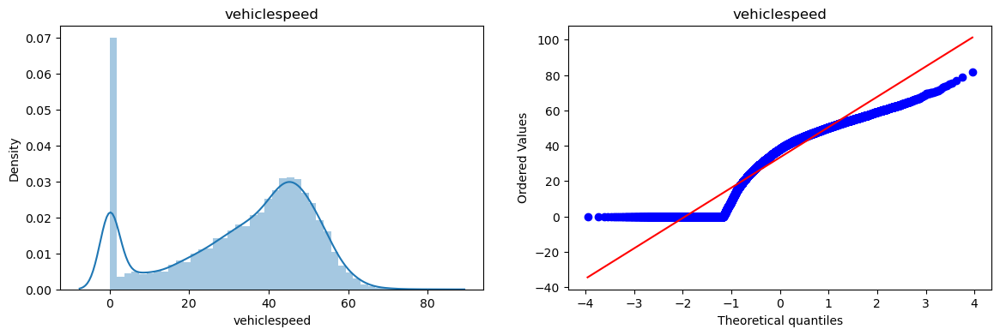

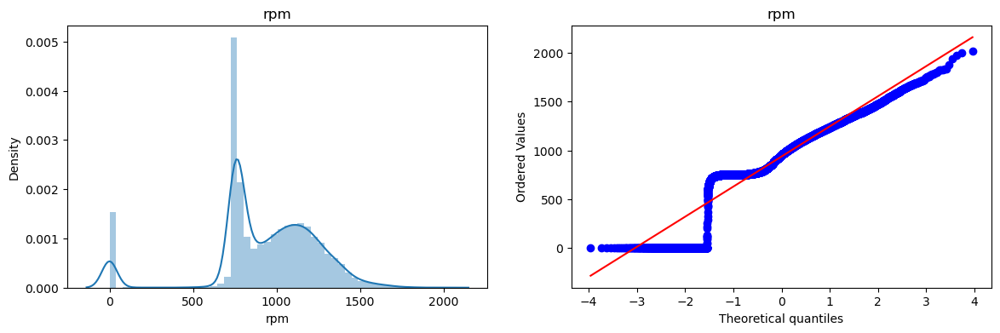

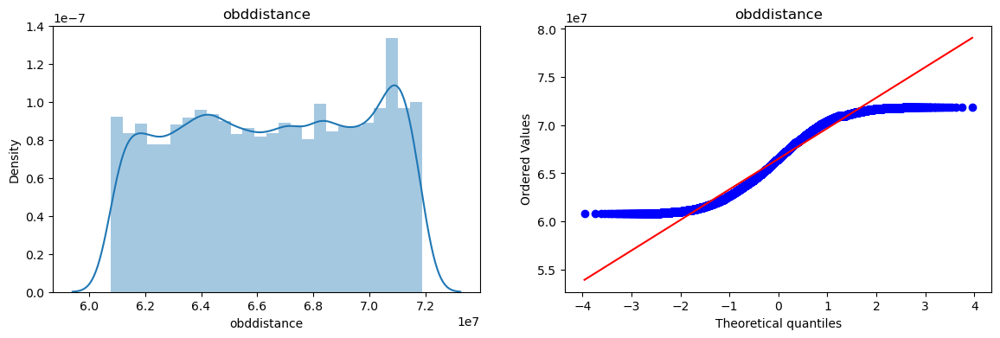

...

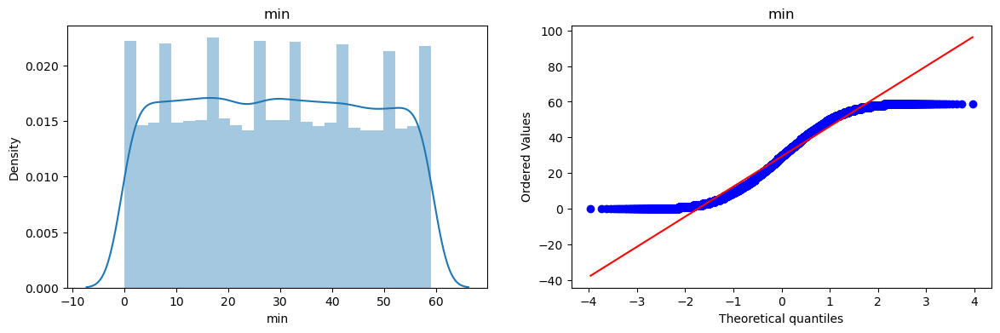

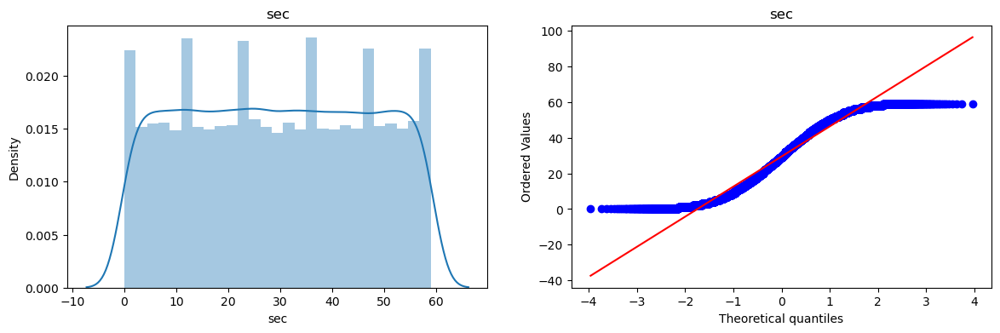

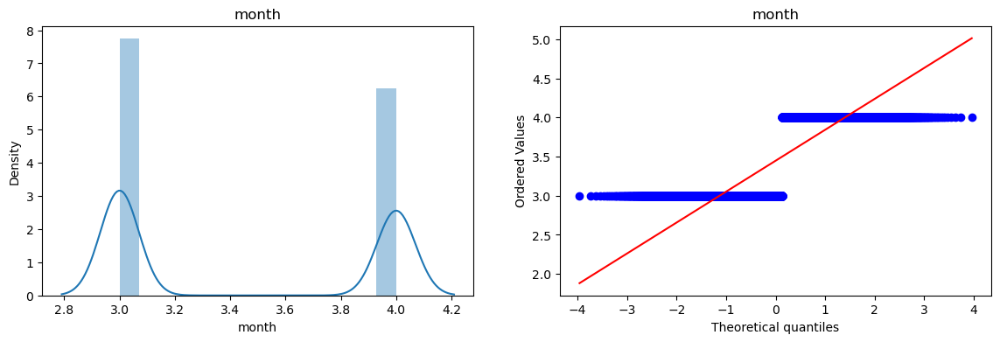

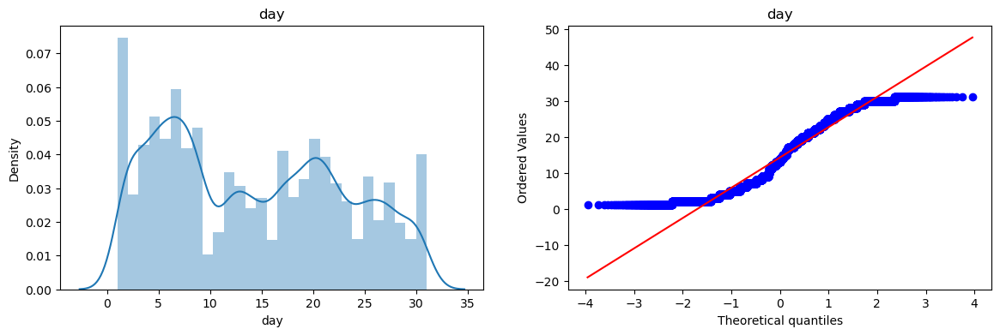

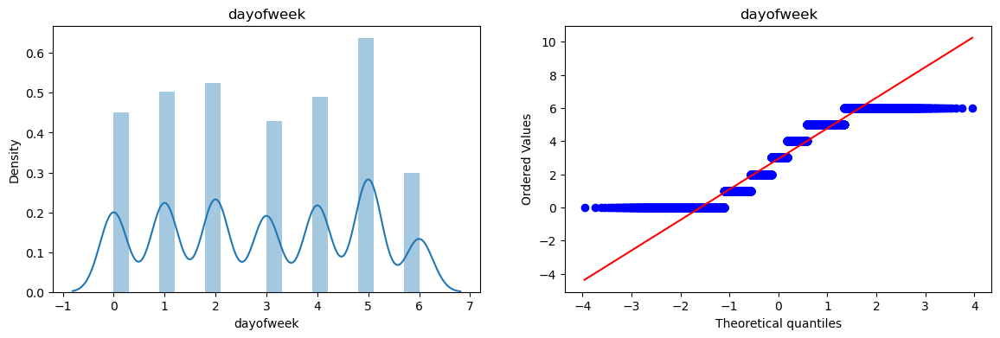

In [58]:
## Normality check using QQ Plot
for col in numerical_columns:
    plt.figure(figsize=(14,4))
    plt.subplot(121)
    sns.distplot(df[col])
    plt.title(col)

    plt.subplot(122)
    stats.probplot(df[col], dist="norm", plot=plt)
    plt.title(col)

    plt.show()

### Univariate analysis

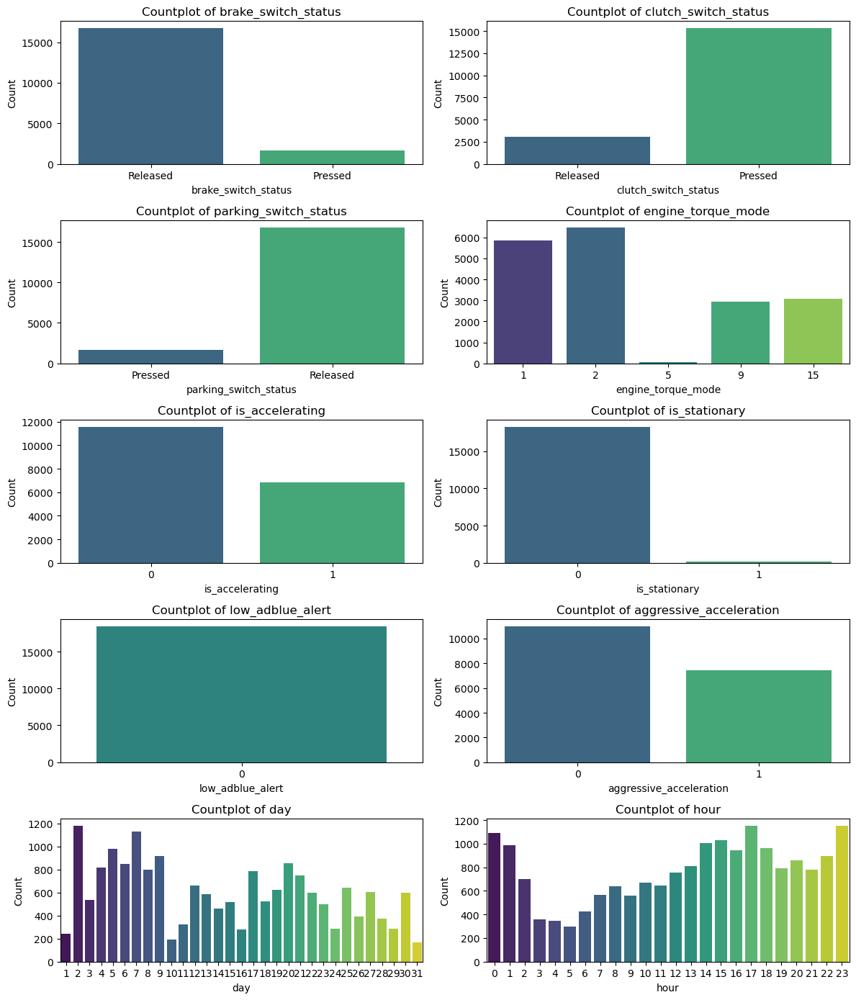

In [60]:
# Countplots

# List of columns to plot
columns_to_plot = ['brake_switch_status', 'clutch_switch_status', 'parking_switch_status', 'engine_torque_mode', 'is_accelerating',
 'is_stationary', 'low_adblue_alert', 'aggressive_acceleration', 'day', 'hour']

# Set up the figure
fig, axes = plt.subplots(5, 2, figsize=(12, 14))  # 2 rows, 2 columns for 4 graphs
axes = axes.flatten()  # Flatten axes for easier indexing

# Iterate over the columns and plot
for i, col in enumerate(columns_to_plot):
    sns.countplot(data=df, x=col, ax=axes[i], palette="viridis")
    axes[i].set_title(f"Countplot of {col}")
    axes[i].set_xlabel(col)
    axes[i].set_ylabel("Count")

# Adjust layout
plt.tight_layout()
plt.show()

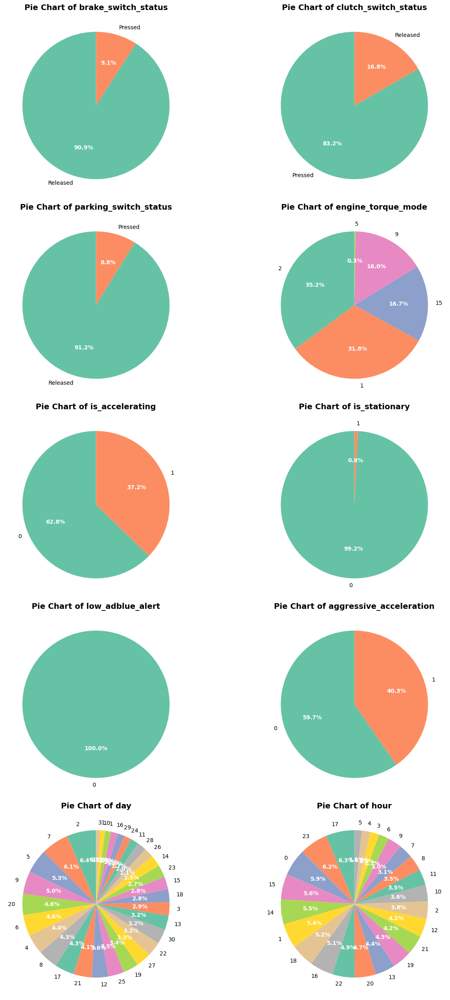

In [61]:
# Piecharts

# Define the columns to plot
columns_to_plot = ['brake_switch_status', 'clutch_switch_status', 'parking_switch_status', 'engine_torque_mode', 'is_accelerating',
 'is_stationary', 'low_adblue_alert', 'aggressive_acceleration', 'day', 'hour']

# Create a custom color palette
colors = sns.color_palette("Set2")

# Set up the figure
fig, axes = plt.subplots(5, 2, figsize=(15, 25))  # 2 rows, 2 columns
axes = axes.flatten()  # Flatten axes for easier indexing

# Plot each column
for i, col in enumerate(columns_to_plot):
    data = df[col].value_counts()  # Get value counts
    wedges, texts, autotexts = axes[i].pie(
        data, 
        labels=data.index, 
        autopct='%1.1f%%', 
        startangle=90, 
        colors=colors[:len(data)],  # Use as many colors as needed
        textprops={'fontsize': 10, 'color': 'black'}  # Format text
    )
    axes[i].set_title(f"Pie Chart of {col}", fontsize=14, fontweight='bold')
    for autotext in autotexts:  # Bold and color the percentages
        autotext.set_color('white')
        autotext.set_fontweight('bold')

# Adjust layout
plt.tight_layout()
plt.show()

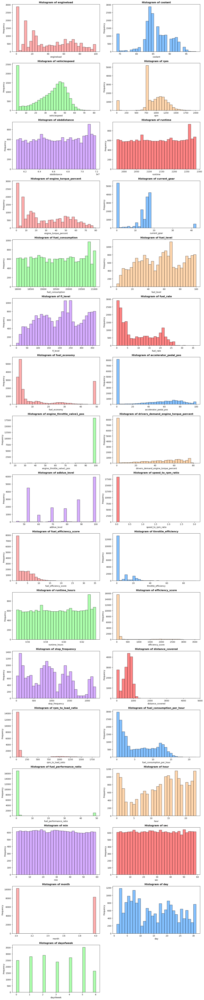

In [62]:
#Histograms

# Define the number of columns per row
num_cols_per_row = 2

# Define the color palette
colors = ['#FF9999', '#66B2FF', '#99FF99', '#FFCC99', '#CC99FF', '#FF6666']

# Calculate the number of rows needed
num_rows = (len(numerical_columns) + 1) // num_cols_per_row

# Set up the figure
fig, axes = plt.subplots(num_rows, num_cols_per_row, figsize=(14, 4 * num_rows))
axes = axes.flatten()  # Flatten axes for easier indexing

# Plot each numerical column
for i, col in enumerate(numerical_columns):
    axes[i].hist(df[col].dropna(), bins=30, color=colors[i % len(colors)], edgecolor="black", alpha=0.8)
    axes[i].set_title(f"Histogram of {col}", fontsize=12, fontweight="bold")
    axes[i].set_xlabel(col, fontsize=10)
    axes[i].set_ylabel("Frequency", fontsize=10)

# Remove unused subplots
for j in range(len(numerical_columns), len(axes)):
    fig.delaxes(axes[j])

# Adjust layout
plt.tight_layout()
plt.show()

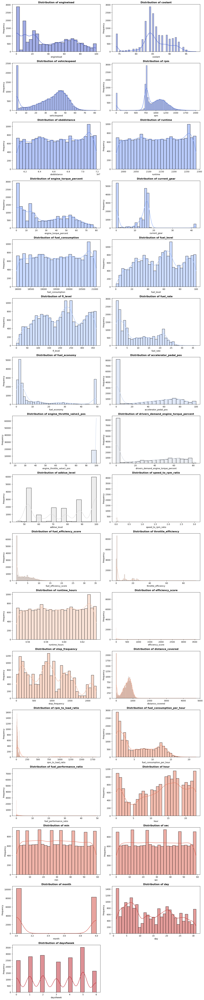

In [63]:
# Distplots

# Define the number of columns per row
num_cols_per_row = 2

# Calculate the number of rows needed
num_rows = (len(numerical_columns) + 1) // num_cols_per_row

# Set up the figure
fig, axes = plt.subplots(num_rows, num_cols_per_row, figsize=(14, 4 * num_rows))
axes = axes.flatten()  # Flatten axes for easier indexing

# Set the color palette
colors = sns.color_palette("coolwarm", len(numerical_columns))

# Plot each numerical column
for i, col in enumerate(numerical_columns):
    sns.histplot(
        df[col].dropna(),
        kde=True,
        ax=axes[i],
        color=colors[i % len(colors)],  # Cycle through colors
    )
    axes[i].set_title(f"Distribution of {col}", fontsize=12, fontweight="bold")
    axes[i].set_xlabel(col, fontsize=10)
    axes[i].set_ylabel("Frequency", fontsize=10)

# Remove unused subplots
for j in range(len(numerical_columns), len(axes)):
    fig.delaxes(axes[j])

# Adjust layout
plt.tight_layout()
plt.show()

### Multivariate analysis

<Axes: >

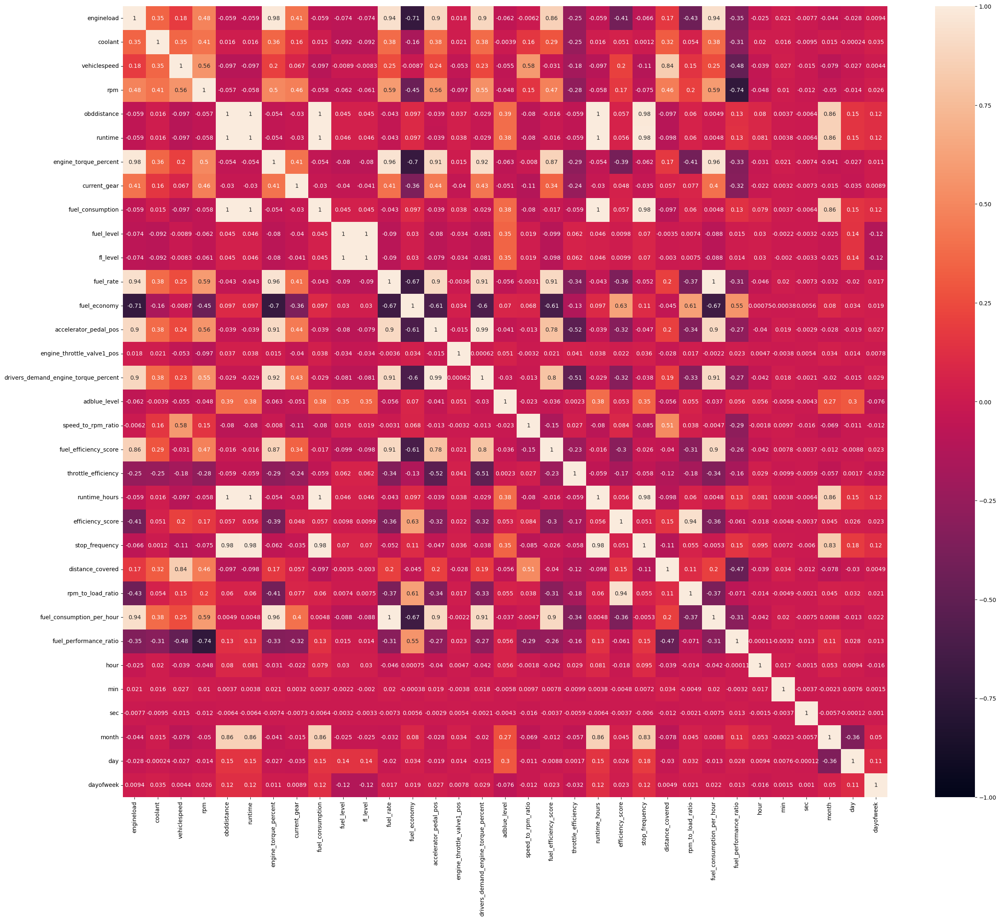

In [65]:
# Heatmap of all the numerical columns in the dataset
plt.figure(figsize=(30,25))
sns.heatmap(df[numerical_columns].corr(),vmin=-1,annot= True)

In [66]:
# Highly (very strongly) correlated variables

correlation_matrix = df[numerical_columns].corr()

# Filter for correlations with absolute value > 0.8
correlation_pairs = (
    correlation_matrix
    .stack()
    .reset_index()
    .rename(columns={'level_0': 'Column1', 'level_1': 'Column2', 0: 'Correlation'})
)

# Remove self-correlations and filter using the absolute value of the correlation
high_correlation = correlation_pairs[
    (correlation_pairs['Column1'] != correlation_pairs['Column2']) &
    (correlation_pairs['Correlation'].abs() > 0.8)
]

# Drop duplicate pairs
high_correlation = high_correlation.drop_duplicates(subset=['Correlation'])

high_correlation

,Column1,Column2,Correlation
6,engineload,engine_torque_percent,0.982212
11,engineload,fuel_rate,0.939175
13,engineload,accelerator_pedal_pos,0.902727
15,engineload,drivers_demand_engine_torque_percent,0.897413
18,engineload,fuel_efficiency_score,0.859623
25,engineload,fuel_consumption_per_hour,0.936209
89,vehiclespeed,distance_covered,0.838592
137,obddistance,runtime,0.999967
140,obddistance,fuel_consumption,0.999959
152,obddistance,runtime_hours,0.999967


In [67]:
# Sort by absolute correlation in descending order
top_correlation = high_correlation.iloc[
    high_correlation['Correlation'].abs().argsort()[::-1]  # Sort by absolute value
]  # Get top 5 pairs

# Get the unique variable names from the top 5 pairs
top_5_variables = pd.unique(top_correlation[['Column1', 'Column2']].values.ravel())[:6]
top_5_variables = list(top_5_variables)
top_5_variables.pop(1)

# Display the result
print("Top 5 Variables with Highest Correlations:", top_5_variables)


Top 5 Variables with Highest Correlations: ['runtime', 'fuel_consumption', 'obddistance', 'fuel_level', 'fl_level']


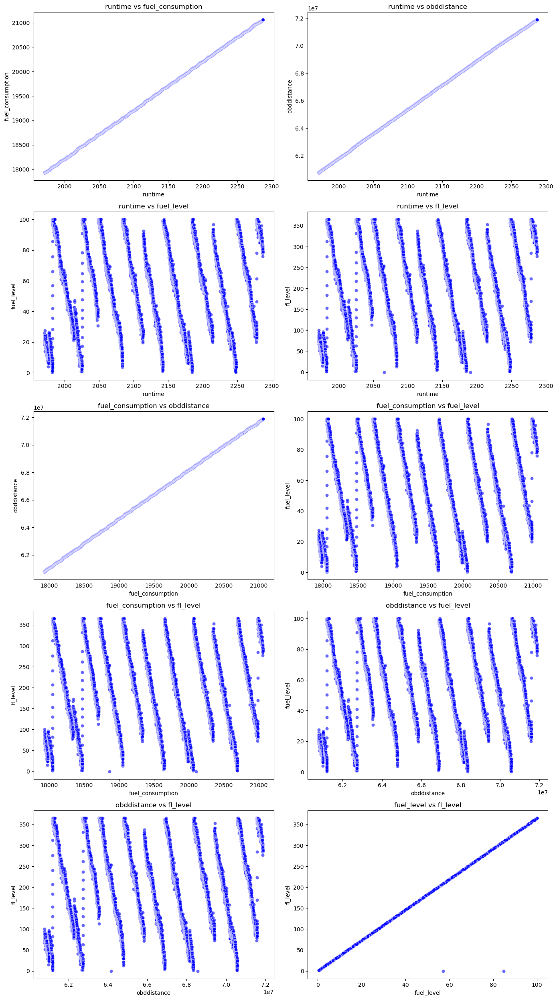

In [68]:
# Scatter plots among to 5 variables as mentioned above
from itertools import combinations

# Create pairwise combinations of the top 5 variables
variable_combinations = list(combinations(top_5_variables, 2))

# Set up the plot grid
ncols = 2  # Number of plots per row
nrows = (len(variable_combinations) + ncols - 1) // ncols  # Calculate required rows
fig, axes = plt.subplots(nrows, ncols, figsize=(14, nrows * 5))
axes = axes.flatten()

# Plot scatter plots for each combination
for i, (var1, var2) in enumerate(variable_combinations):
    sns.scatterplot(data=df, x=var1, y=var2, ax=axes[i], alpha=0.6, color='blue')
    axes[i].set_title(f"{var1} vs {var2}", fontsize=12)
    axes[i].set_xlabel(var1)
    axes[i].set_ylabel(var2)

# Remove unused axes
for j in range(len(variable_combinations), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

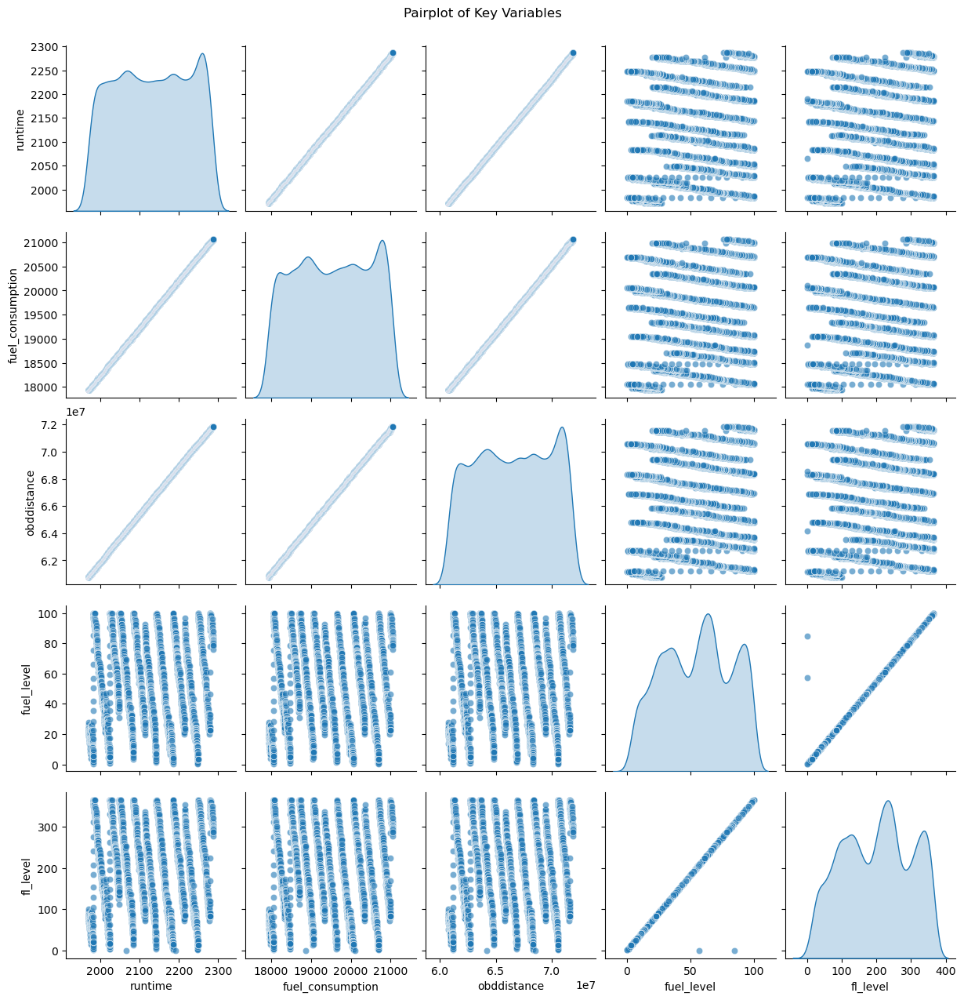

In [69]:
# Scatter plots among to 5 variables as mentioned above

sns.pairplot(df[top_5_variables], diag_kind='kde', plot_kws={'alpha': 0.6})
plt.suptitle("Pairplot of Key Variables", y=1.02)
plt.show()

### Time series analysis

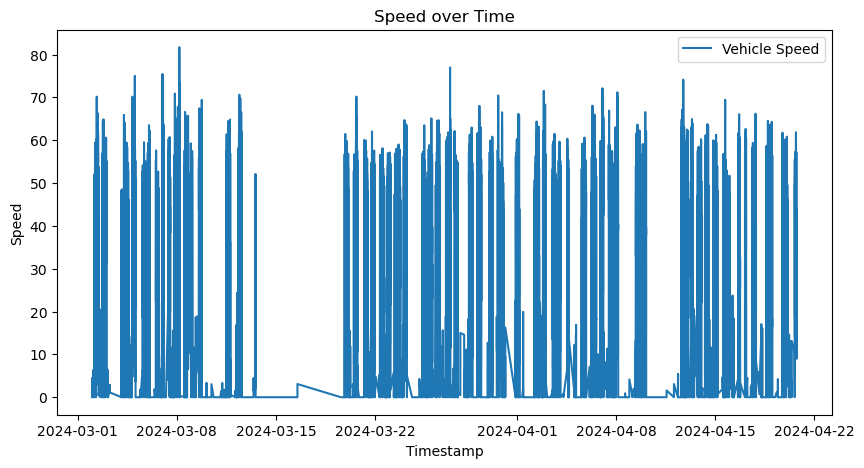

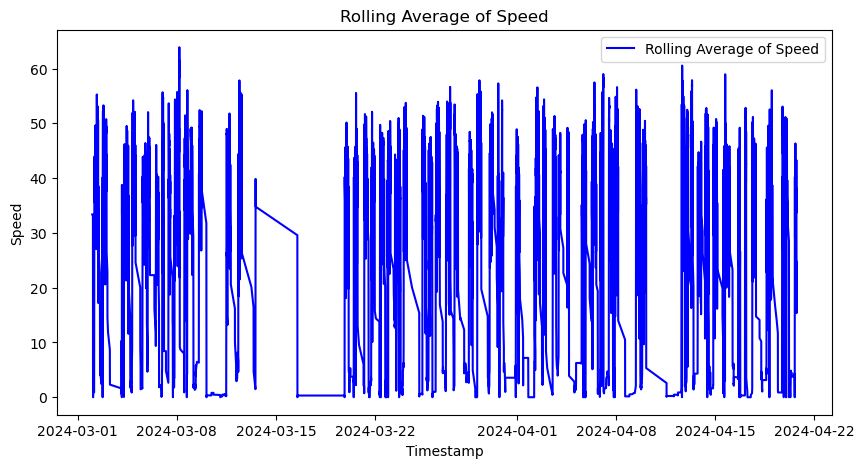

In [71]:
# Trend Analysis

plt.figure(figsize=(10, 5))
plt.plot(df['ts'], df['vehiclespeed'], label='Vehicle Speed')
plt.xlabel('Timestamp')
plt.ylabel('Speed')
plt.title("Speed over Time")
plt.legend()
plt.show()

# Calculate rolling average
df['speed_rolling_avg'] = df['vehiclespeed'].rolling(window=10).mean()

df['speed_rolling_avg'].fillna(df['speed_rolling_avg'].mean(), inplace=True)

# Plot
plt.figure(figsize=(10, 5))
plt.plot(df['ts'], df['speed_rolling_avg'], label='Rolling Average of Speed', color='blue')
plt.xlabel('Timestamp')
plt.ylabel('Speed')
plt.title("Rolling Average of Speed")
plt.legend()
plt.show()

### Geospatial visualizations

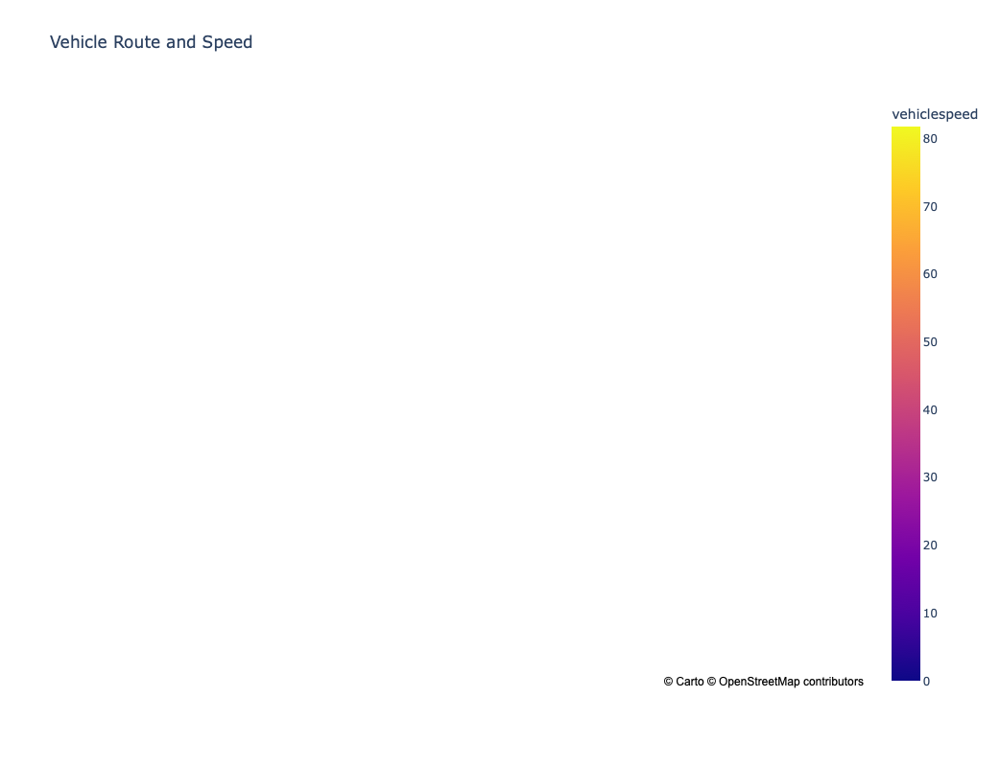

In [73]:
# Route Mapping

fig = px.scatter_mapbox(
    df, lat='lat', lon='lng', color='vehiclespeed',
    mapbox_style='carto-positron', zoom=10, title="Vehicle Route and Speed",
    width=900,  # Adjust the width
    height=800 
)
fig.show()

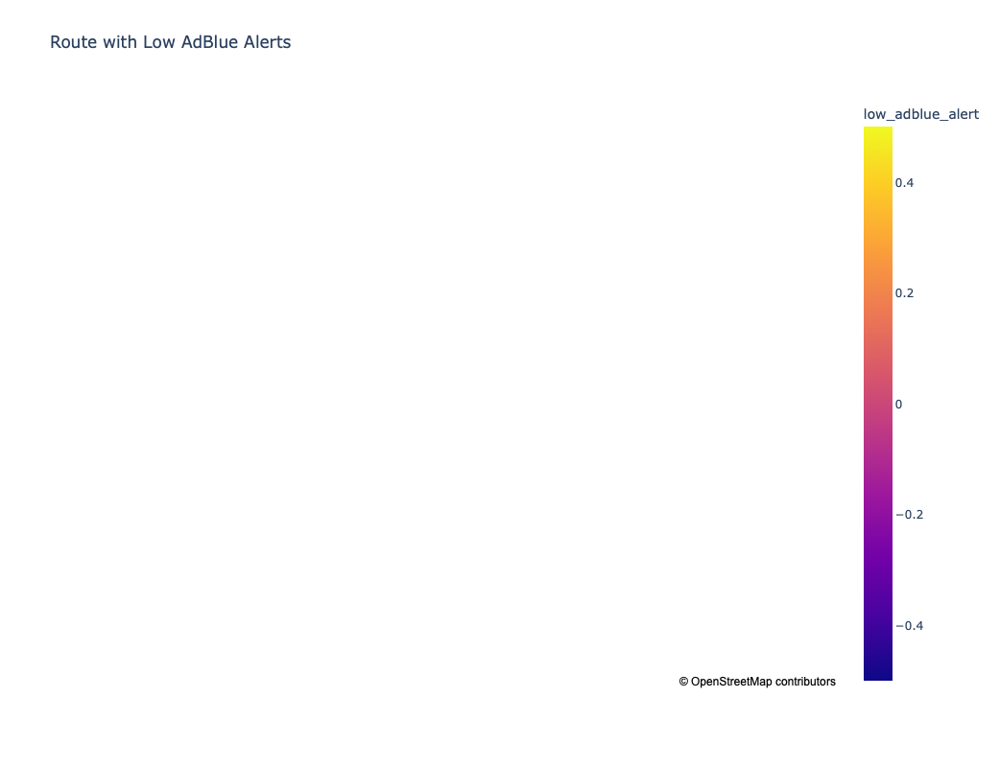

In [74]:
# Route with low AdBlue alerts
fig = px.scatter_mapbox(
    df, lat='lat', lon='lng', color='low_adblue_alert',
    mapbox_style='open-street-map', zoom=10, title="Route with Low AdBlue Alerts",
    width=900,  # Adjust the width
    height=800 
)
fig.show()

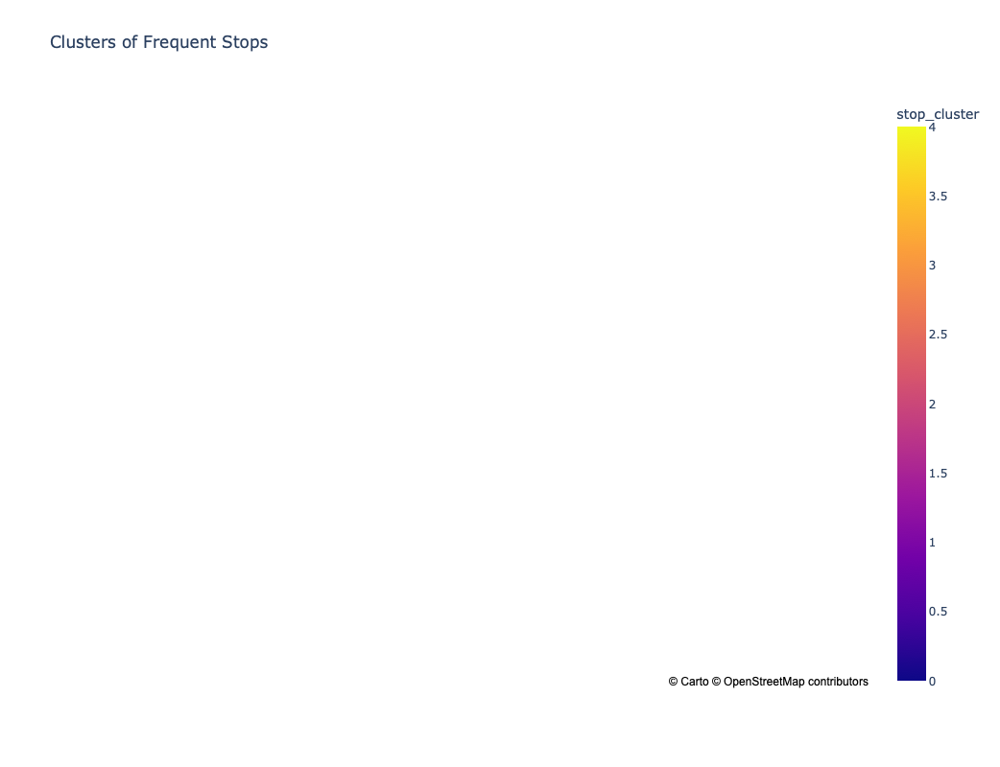

In [75]:
# CLusters of frequent stops

from sklearn.cluster import KMeans

# Clustering
coords = df[['lat', 'lng']].dropna()
kmeans = KMeans(n_clusters=5, random_state=42).fit(coords)
df['stop_cluster'] = kmeans.labels_

# Visualize clusters
fig = px.scatter_mapbox(
    df, lat='lat', lon='lng', color='stop_cluster',
    mapbox_style='carto-positron', zoom=10, title="Clusters of Frequent Stops",
    width=900,  # Adjust the width
    height=800 
)
fig.show()

## Encoding categorical variables (OneHotEncoding)

In [77]:
categorical_columns=[]
numerical_columns=[]
for e in df.columns:
    if df[e].dtypes=="O":
        categorical_columns.append(e)
    else:
        numerical_columns.append(e)
print("Categorical columns: ", categorical_columns)
print(len(categorical_columns))
print()
print("Numerical columns: ", numerical_columns)
print(len(numerical_columns))

Categorical columns:  ['pluscode', 'can_raw_data', 'brake_switch_status', 'clutch_switch_status', 'parking_switch_status', 'region_code']
6

Numerical columns:  ['ts', 'lat', 'lng', 'engineload', 'coolant', 'vehiclespeed', 'rpm', 'obddistance', 'runtime', 'engine_torque_percent', 'current_gear', 'fuel_consumption', 'fuel_level', 'fl_level', 'fuel_rate', 'fuel_economy', 'accelerator_pedal_pos', 'engine_throttle_valve1_pos', 'drivers_demand_engine_torque_percent', 'engine_torque_mode', 'adblue_level', 'speed_to_rpm_ratio', 'fuel_efficiency_score', 'throttle_efficiency', 'runtime_hours', 'is_accelerating', 'is_stationary', 'low_adblue_alert', 'efficiency_score', 'aggressive_acceleration', 'stop_frequency', 'distance_covered', 'rpm_to_load_ratio', 'fuel_consumption_per_hour', 'fuel_performance_ratio', 'hour', 'min', 'sec', 'month', 'day', 'dayofweek', 'speed_rolling_avg', 'stop_cluster']
43


In [78]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18434 entries, 0 to 18433
Data columns (total 49 columns):
 #   Column                                Non-Null Count  Dtype         
---  ------                                --------------  -----         
 0   ts                                    18434 non-null  datetime64[ns]
 1   lat                                   18434 non-null  float64       
 2   lng                                   18434 non-null  float64       
 3   engineload                            18434 non-null  float64       
 4   coolant                               18434 non-null  float64       
 5   vehiclespeed                          18434 non-null  float64       
 6   rpm                                   18434 non-null  float64       
 7   obddistance                           18434 non-null  float64       
 8   runtime                               18434 non-null  float64       
 9   engine_torque_percent                 18434 non-null  float64       
 10

In [79]:
# OneHotEncoding

from sklearn.preprocessing import OneHotEncoder
import numpy as np

# Columns to apply one-hot encoding
ohe_columns = ['brake_switch_status', 'clutch_switch_status', 'parking_switch_status']

encoder = OneHotEncoder(sparse_output=False, drop="first")

# Fit and transform the specified columns
encoded_data = encoder.fit_transform(df[ohe_columns])

# Get the new column names based on categories
encoded_columns = encoder.get_feature_names_out(ohe_columns)

# Create a DataFrame for the encoded data
encoded_df = pd.DataFrame(encoded_data, columns=encoded_columns, index=df.index)

# Drop the original columns from the dataframe
df_remaining = df.drop(columns=ohe_columns)

# Concatenate the one-hot encoded dataframe with the remaining dataframe
df_final = pd.concat([df_remaining, encoded_df], axis=1)


df_final.head()

,ts,lat,lng,engineload,coolant,vehiclespeed,rpm,obddistance,runtime,engine_torque_percent,...,min,sec,month,day,dayofweek,speed_rolling_avg,stop_cluster,brake_switch_status_Released,clutch_switch_status_Released,parking_switch_status_Released
0,2024-03-02 00:52:11,19.069340,78.355148,28.0,74.0,0.00000,749.000,60780800.0,1970.85,21.0,...,52,11,3,2,5,33.372352,2,1.0,1.0,0.0
1,2024-03-02 00:53:14,19.069347,78.355141,22.0,74.0,0.00000,1208.375,60780800.0,1970.85,18.0,...,53,14,3,2,5,33.372352,2,1.0,0.0,0.0
2,2024-03-02 00:54:17,19.069414,78.355179,25.0,74.0,1.40625,752.625,60780800.0,1970.85,18.0,...,54,17,3,2,5,33.372352,2,0.0,0.0,1.0
3,2024-03-02 00:55:20,19.069258,78.355225,35.0,74.0,2.81250,996.375,60780820.0,1970.90,27.0,...,55,20,3,2,5,33.372352,2,1.0,0.0,1.0
4,2024-03-02 00:56:23,19.069094,78.355339,0.0,74.0,4.53125,1065.750,60780840.0,1970.90,1.0,...,56,23,3,2,5,33.372352,2,1.0,0.0,1.0


In [80]:
df.shape

(18434, 49)

In [81]:
categorical_columns=[]
numerical_columns=[]
for e in df_final.columns:
    if df_final[e].dtypes=="O":
        categorical_columns.append(e)
    else:
        numerical_columns.append(e)
print("Categorical columns: ", categorical_columns)
print(len(categorical_columns))
print()
print("Numerical columns: ", numerical_columns)
print(len(numerical_columns))

Categorical columns:  ['pluscode', 'can_raw_data', 'region_code']
3

Numerical columns:  ['ts', 'lat', 'lng', 'engineload', 'coolant', 'vehiclespeed', 'rpm', 'obddistance', 'runtime', 'engine_torque_percent', 'current_gear', 'fuel_consumption', 'fuel_level', 'fl_level', 'fuel_rate', 'fuel_economy', 'accelerator_pedal_pos', 'engine_throttle_valve1_pos', 'drivers_demand_engine_torque_percent', 'engine_torque_mode', 'adblue_level', 'speed_to_rpm_ratio', 'fuel_efficiency_score', 'throttle_efficiency', 'runtime_hours', 'is_accelerating', 'is_stationary', 'low_adblue_alert', 'efficiency_score', 'aggressive_acceleration', 'stop_frequency', 'distance_covered', 'rpm_to_load_ratio', 'fuel_consumption_per_hour', 'fuel_performance_ratio', 'hour', 'min', 'sec', 'month', 'day', 'dayofweek', 'speed_rolling_avg', 'stop_cluster', 'brake_switch_status_Released', 'clutch_switch_status_Released', 'parking_switch_status_Released']
46


## PCA

In [83]:
numerical_columns.remove("ts")
numerical_columns.remove("lat")
numerical_columns.remove("lng")

In [84]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

### Standardization

In [86]:
# Standardize the data
scaler = StandardScaler()
scaled_data = scaler.fit_transform(df_final[numerical_columns])

In [87]:
# Apply PCA
pca = PCA()
pca_data = pca.fit_transform(scaled_data)

# Create a DataFrame for the PCA results
pca_df = pd.DataFrame(pca_data, columns=[f'PC{i+1}' for i in range(len(numerical_columns))])
pca_df

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,...,PC34,PC35,PC36,PC37,PC38,PC39,PC40,PC41,PC42,PC43
0,-2.666372,3.664661,-5.498540,-0.989582,-2.498970,0.762504,0.320655,-1.066289,-1.983928,-0.451943,...,-0.024393,-0.060825,0.027316,0.013636,-0.031793,0.005979,-0.004514,0.006151,-5.510807e-15,-2.686772e-16
1,-0.471195,3.380314,-3.876149,-0.939675,-1.715226,-0.911081,-0.577336,-0.332291,1.690425,0.933195,...,-0.165386,0.186208,-0.070755,0.011328,-0.019643,0.004927,-0.004163,0.005882,-5.357950e-15,-5.026686e-16
2,-1.191751,4.215312,-2.431426,1.503891,-4.010167,-2.873589,-1.131643,-1.783682,1.093389,1.491111,...,-0.053098,-0.011876,0.020992,0.024361,-0.029853,-0.002739,-0.005938,0.006090,-3.751619e-15,-2.390979e-16
3,1.503164,3.483241,-2.597260,-0.483904,-2.250136,-2.850171,-1.151456,0.385064,2.766624,0.310694,...,-0.100102,0.351487,-0.037193,0.019195,-0.012352,-0.003147,-0.005018,0.005999,3.053363e-15,4.010089e-16
4,-3.217307,4.451134,-0.779378,-2.411833,-1.188063,-2.218376,-0.535353,0.042070,1.883486,0.209438,...,0.116169,-0.137850,0.027971,0.016977,-0.062759,0.000571,-0.005895,0.006043,6.154146e-14,-1.122788e-15
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18429,0.165675,-4.116720,0.365324,0.993460,-0.105620,-0.392922,0.143547,0.850381,1.029185,0.096707,...,-0.020210,-0.057349,-0.024434,0.044871,0.002443,0.001264,0.006912,0.001436,2.040944e-15,-5.699515e-18
18430,-3.745716,-2.945509,4.050111,-1.739533,0.992249,-2.509144,-0.040885,0.000177,-0.111823,0.489717,...,0.027589,-0.049610,-0.012833,0.033599,0.046240,0.000939,0.006572,0.001049,-1.228699e-15,3.592230e-17
18431,-3.053873,-3.139830,1.666389,1.159894,-0.328457,1.427045,0.448917,-0.338630,-0.336528,1.029738,...,-0.013072,-0.090385,0.000051,0.036031,0.048816,0.001496,0.007166,0.001404,-8.154178e-16,3.065102e-17
18432,0.554104,-4.309589,-0.057635,0.642535,0.253833,-0.328943,0.122494,0.982424,1.605841,-0.867228,...,-0.073709,-0.082778,0.039494,0.042446,-0.009449,0.000761,0.007150,0.001417,-9.656580e-16,1.998294e-17


In [88]:
pca_df.shape

(18434, 43)

In [89]:
# Explained variance ratio

explained_variance = pca.explained_variance_ratio_
explained_variance

array([2.25485246e-01, 1.44298415e-01, 1.06657279e-01, 5.82417436e-02,
       5.24697544e-02, 4.43143137e-02, 3.08703674e-02, 2.71026981e-02,
       2.58100542e-02, 2.48148464e-02, 2.39115149e-02, 2.38001532e-02,
       2.34859744e-02, 2.15249025e-02, 1.99755877e-02, 1.90042487e-02,
       1.77419058e-02, 1.57833732e-02, 1.51576406e-02, 1.31502640e-02,
       1.23397848e-02, 1.12010747e-02, 8.50637688e-03, 8.05013829e-03,
       6.06523552e-03, 5.28427345e-03, 4.31782006e-03, 3.50892257e-03,
       1.76938925e-03, 1.60963217e-03, 1.22904831e-03, 9.63179431e-04,
       4.94111340e-04, 4.47895161e-04, 3.90062652e-04, 1.28430019e-04,
       6.46599972e-05, 1.95332360e-05, 9.38435017e-06, 3.95009160e-07,
       3.69973964e-07, 4.44691239e-32, 1.76299011e-33])

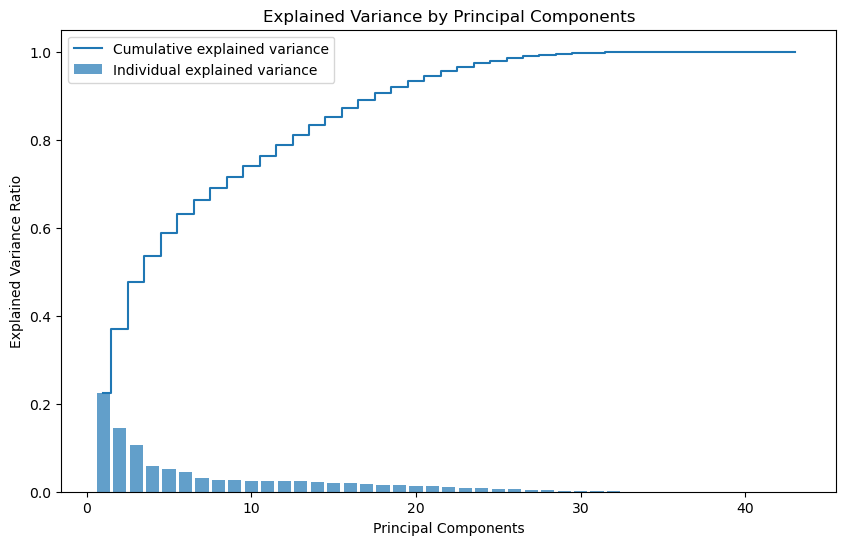

In [90]:
# Plot the explained variance

plt.figure(figsize=(10, 6))
plt.bar(range(1, len(explained_variance) + 1), explained_variance, alpha=0.7, align='center', label='Individual explained variance')
plt.step(range(1, len(explained_variance) + 1), np.cumsum(explained_variance), where='mid', label='Cumulative explained variance')
plt.xlabel('Principal Components')
plt.ylabel('Explained Variance Ratio')
plt.title('Explained Variance by Principal Components')
plt.legend(loc='best')
plt.show()


In [91]:
# Determine the number of components to retain (e.g., 90% variance)
cumulative_variance = np.cumsum(explained_variance)
components_to_retain = np.argmax(cumulative_variance >= 0.90) + 1
print(f"Number of components to retain 90% variance: {components_to_retain}")

Number of components to retain 90% variance: 18


In [92]:
# Transform the data using the selected number of components
pca_reduced = PCA(n_components=components_to_retain)
reduced_data = pca_reduced.fit_transform(scaled_data)

In [93]:
# Transform the data using the selected number of components
pca_df_opt = pd.DataFrame(
    reduced_data, 
    columns=[f'PC{i+1}' for i in range(components_to_retain)],
    index=df.index  # Ensure index alignment with the original dataframe
)

pca_df_opt.head()

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12,PC13,PC14,PC15,PC16,PC17,PC18
0,-2.666372,3.664661,-5.498540,-0.989582,-2.498971,0.762506,0.320640,-1.066277,-1.983920,-0.451980,-3.678186,-0.869735,4.934537,8.529233,1.132921,3.061286,-3.137636,0.135572
1,-0.471195,3.380314,-3.876149,-0.939674,-1.715227,-0.911077,-0.577360,-0.332271,1.690435,0.933133,0.161781,-1.447559,-0.839942,0.694705,0.001364,1.951566,-0.870376,-0.958543
2,-1.191751,4.215312,-2.431426,1.503892,-4.010168,-2.873588,-1.131653,-1.783674,1.093392,1.491084,-0.100463,-1.298677,-0.901646,1.614927,-0.107893,0.750838,1.605853,1.493426
3,1.503164,3.483241,-2.597260,-0.483903,-2.250138,-2.850167,-1.151485,0.385087,2.766629,0.310617,-0.284560,-1.764575,-1.090545,1.393010,-0.691736,2.196353,0.440665,-0.025829
4,-3.217307,4.451134,-0.779378,-2.411835,-1.188061,-2.218383,-0.535309,0.042032,1.883512,0.209577,0.004102,-1.461644,-1.439488,1.026136,0.234247,1.418784,-0.503372,-0.860158


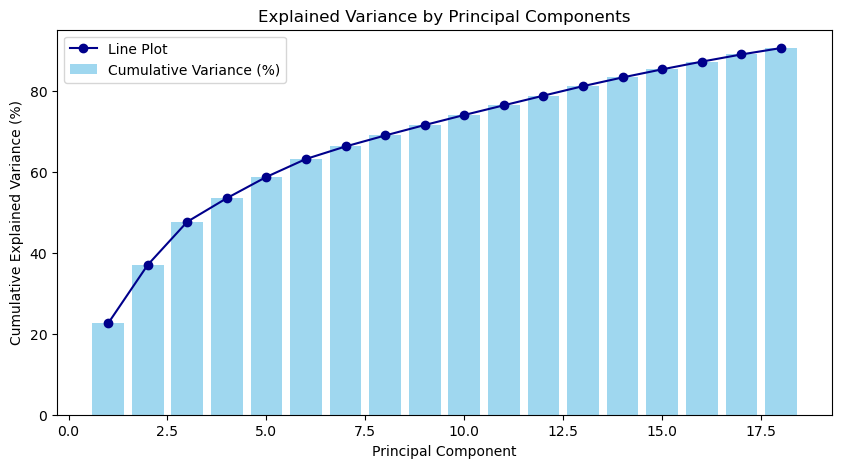

In [94]:
# Explained variance by PC's

plt.figure(figsize=(10, 5))
explained_variance = np.cumsum(PCA(n_components=components_to_retain).fit(scaled_data).explained_variance_ratio_) * 100
plt.bar(range(1, components_to_retain + 1), explained_variance, color='skyblue', alpha=0.8, label='Cumulative Variance (%)')
plt.plot(range(1, components_to_retain + 1), explained_variance, color='darkblue', marker='o', label='Line Plot')
plt.xlabel('Principal Component')
plt.ylabel('Cumulative Explained Variance (%)')
plt.title('Explained Variance by Principal Components')
plt.legend()
plt.show()

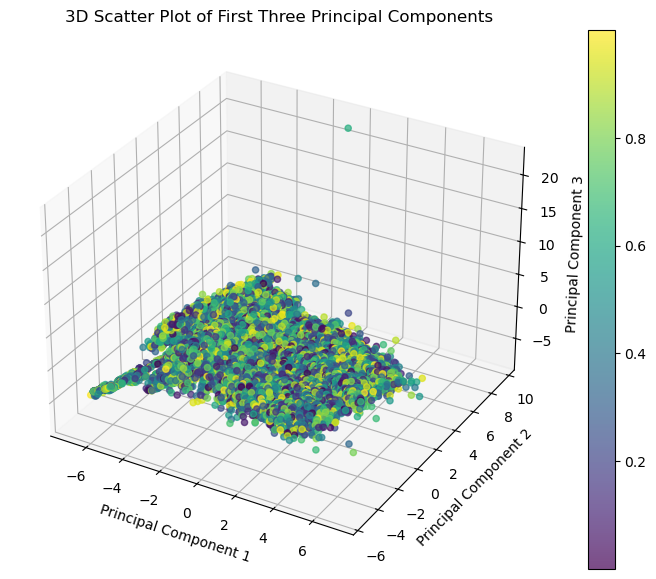

In [95]:
# Create a 3D scatter plot among top 3 PC's

from mpl_toolkits.mplot3d import Axes3D

fig = plt.figure(figsize=(10, 7))
ax = fig.add_subplot(111, projection='3d')
scatter = ax.scatter(
    pca_df_opt['PC1'], pca_df_opt['PC2'], pca_df_opt['PC3'],
    c=np.random.rand(len(pca_df_opt)), cmap='viridis', alpha=0.7
)
ax.set_xlabel('Principal Component 1')
ax.set_ylabel('Principal Component 2')
ax.set_zlabel('Principal Component 3')
plt.title('3D Scatter Plot of First Three Principal Components')
plt.colorbar(scatter, ax=ax)
plt.show()

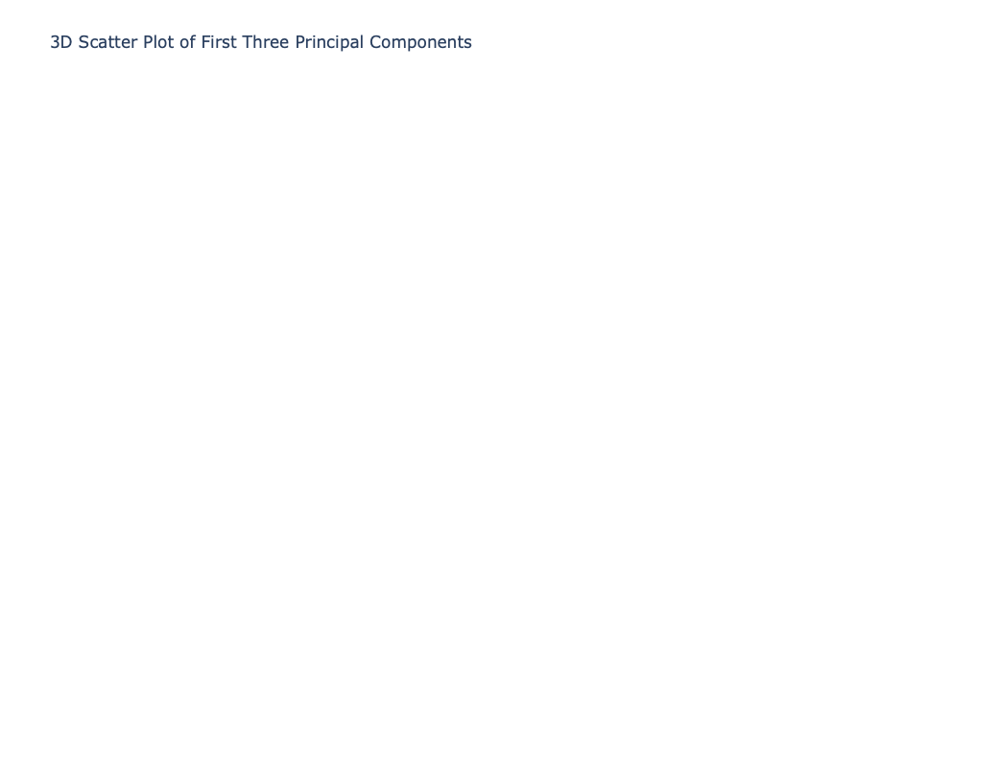

In [96]:
# Create an interactive 3D scatter plot with Plotly

fig = go.Figure(data=[go.Scatter3d(
    x=pca_df_opt['PC1'],
    y=pca_df_opt['PC2'],
    z=pca_df_opt['PC3'],
    mode='markers',
    marker=dict(
        size=5,
        color=np.random.rand(len(pca_df_opt)),  # Random color for each point
        colorscale='Viridis',  # Choose a color scale
        opacity=0.7
    )
)])

# Update layout for better labeling and bigger figure size
fig.update_layout(
    scene=dict(
        xaxis_title='Principal Component 1',
        yaxis_title='Principal Component 2',
        zaxis_title='Principal Component 3'
    ),
    title='3D Scatter Plot of First Three Principal Components',
    coloraxis_colorbar=dict(title='Random Color Scale'),
    width=1000,  # Set width of the plot
    height=800   # Set height of the plot
)

# Show the plot
fig.show()

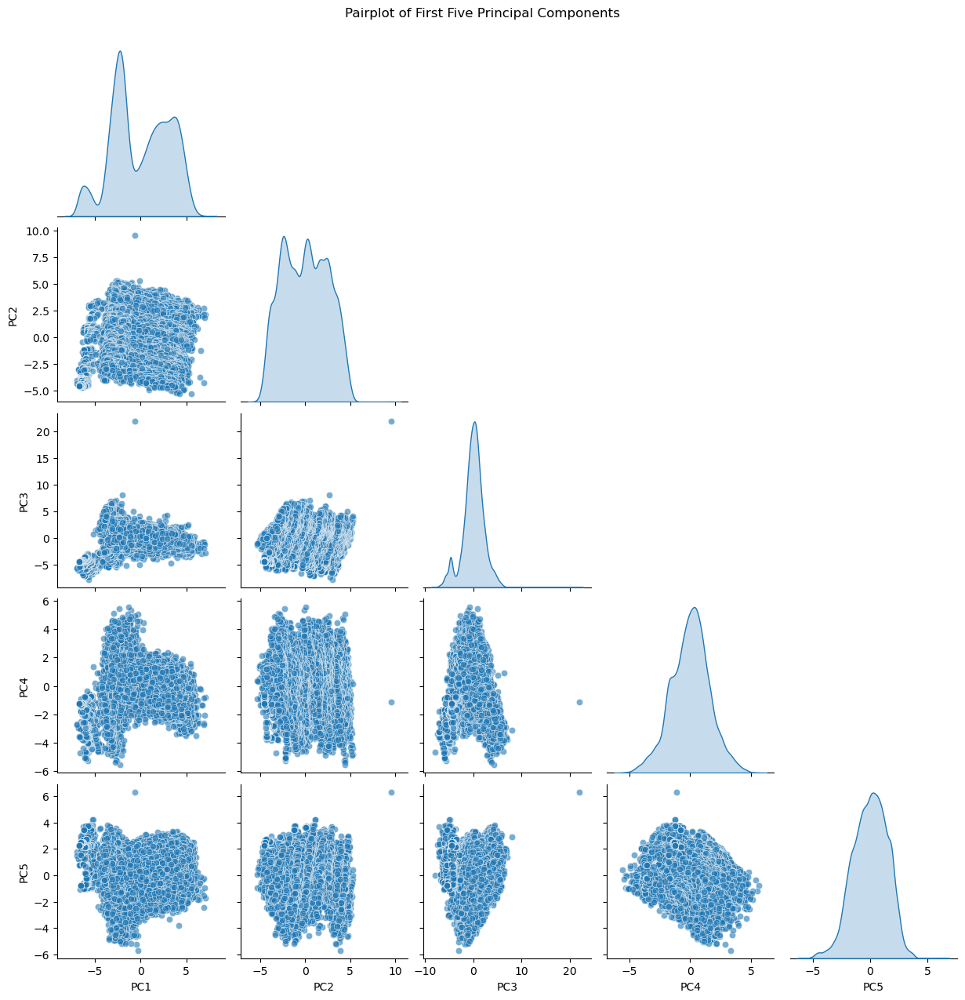

In [97]:
#Pairplot on the first 5 PC's

sns.pairplot(pca_df_opt.iloc[:, :5], diag_kind='kde', corner=True, plot_kws={'alpha': 0.6})
plt.suptitle('Pairplot of First Five Principal Components', y=1.02)
plt.show()

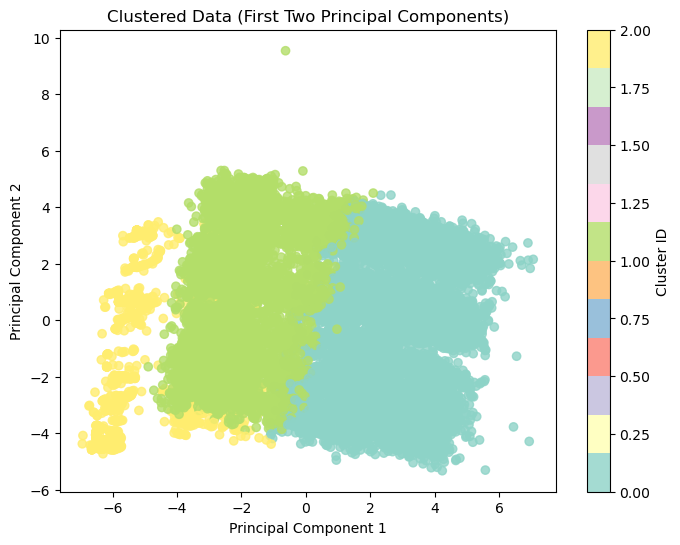

In [98]:
#Apply clustering on the first 2 PC's

from sklearn.cluster import KMeans

# Apply KMeans
kmeans = KMeans(n_clusters=3, random_state=42)
clusters = kmeans.fit_predict(pca_df_opt.iloc[:, :3])

# Scatter plot of clustered data
plt.figure(figsize=(8, 6))
plt.scatter(pca_df_opt['PC1'], pca_df_opt['PC2'], c=clusters, cmap='Set3', alpha=0.8, label='Clusters')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('Clustered Data (First Two Principal Components)')
plt.colorbar(label='Cluster ID')
plt.show()

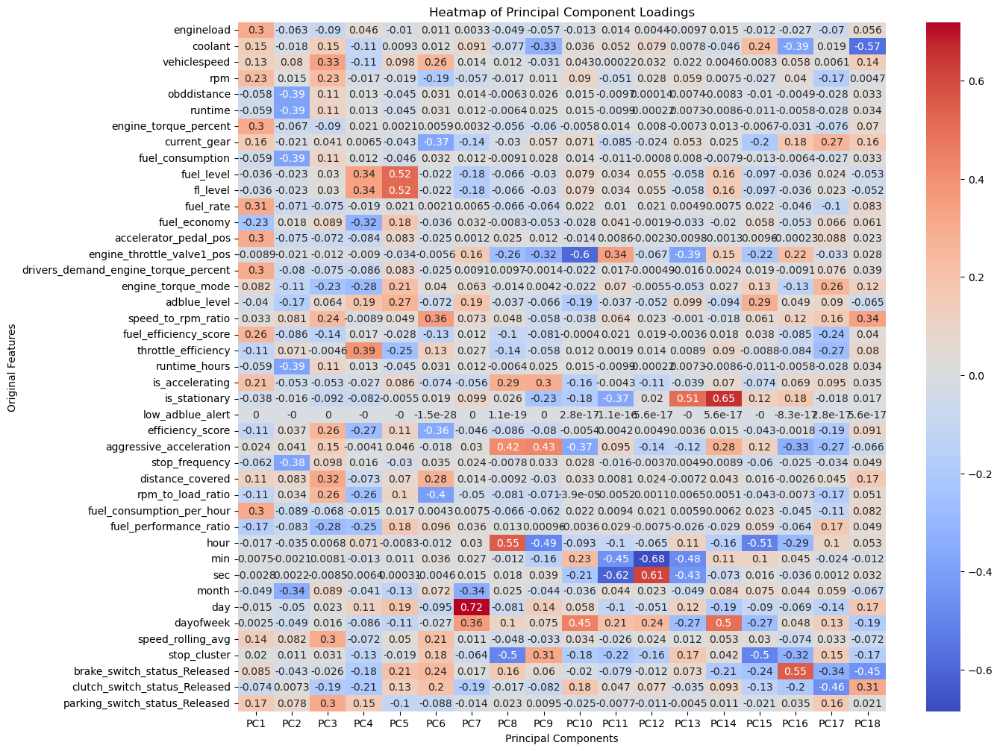

In [99]:
# Creating a heatmap containing the PC's and their dependencies on all features in the dataset

pca_model = pca_reduced
loadings = pd.DataFrame(
    pca_model.components_,
    columns=numerical_columns,
    index=[f'PC{i+1}' for i in range(components_to_retain)]
)

plt.figure(figsize=(14, 12))
sns.heatmap(loadings.T, cmap='coolwarm', annot=True)
plt.title('Heatmap of Principal Component Loadings')
plt.xlabel('Principal Components')
plt.ylabel('Original Features')
plt.show()

In [100]:
# Creating a dataframe containing the PC's and the top 5 features on which these PC's are most dependent on

def get_top_features_per_pc(loadings, num_features=5):
  top_features_per_pc = []
  for pc, row in loadings.iterrows():
    # Sort features by absolute loading values in descending order
    sorted_features = row.sort_values(ascending=False).index[:num_features]
    top_features_per_pc.append((pc, *sorted_features))

  return pd.DataFrame(top_features_per_pc, columns=['PC', 'Top Feature 1', 'Top Feature 2', 'Top Feature 3', 'Top Feature 4', 'Top Feature 5'])
    
top5_features_df = get_top_features_per_pc(loadings.copy())
top5_features_df


,PC,Top Feature 1,Top Feature 2,Top Feature 3,Top Feature 4,Top Feature 5
0,PC1,fuel_rate,engine_torque_percent,fuel_consumption_per_hour,accelerator_pedal_pos,engineload
1,PC2,distance_covered,speed_rolling_avg,speed_to_rpm_ratio,vehiclespeed,parking_switch_status_Released
2,PC3,vehiclespeed,distance_covered,parking_switch_status_Released,speed_rolling_avg,efficiency_score
3,PC4,throttle_efficiency,fl_level,fuel_level,adblue_level,parking_switch_status_Released
4,PC5,fuel_level,fl_level,adblue_level,brake_switch_status_Released,engine_torque_mode
5,PC6,speed_to_rpm_ratio,distance_covered,vehiclespeed,brake_switch_status_Released,speed_rolling_avg
6,PC7,day,dayofweek,adblue_level,engine_throttle_valve1_pos,is_stationary
7,PC8,hour,aggressive_acceleration,is_accelerating,brake_switch_status_Released,dayofweek
8,PC9,aggressive_acceleration,stop_cluster,is_accelerating,day,dayofweek
9,PC10,dayofweek,min,clutch_switch_status_Released,rpm,fuel_level


## Gaining additional insights

### Fuel Efficiency Analysis

In [103]:
df['fuel_consumption'].mean()

19533.06892155799

In [104]:
df['fuel_economy'].describe()

count    18434.000000
mean        13.492928
std         17.520889
min          0.000000
25%          1.933594
50%          3.456055
75%         20.906250
max         49.365234
Name: fuel_economy, dtype: float64

In [105]:
df.groupby(pd.qcut(df['vehiclespeed'], 5))['fuel_consumption'].mean()

vehiclespeed
(-0.001, 16.591]    19670.345810
(16.591, 33.078]    19628.037899
(33.078, 42.172]    19451.841434
(42.172, 48.703]    19398.618725
(48.703, 81.703]    19516.150204
Name: fuel_consumption, dtype: float64

In [106]:
# Calculate correlation between speed and fuel economy
df[['vehiclespeed', 'fuel_economy']].corr().iloc[0,1]

-0.008696299497497154

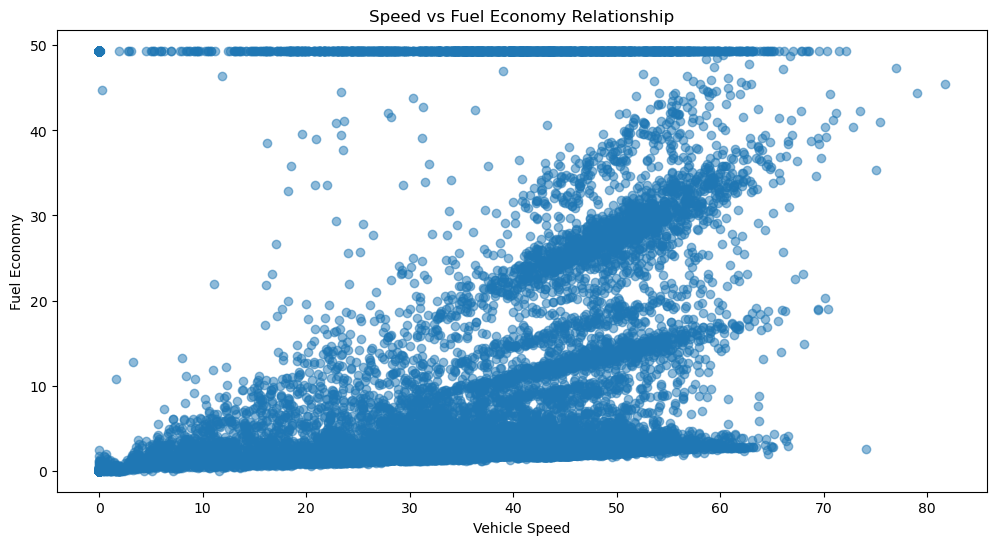

In [107]:
# Create visualization
plt.figure(figsize=(12, 6))
plt.scatter(df['vehiclespeed'], df['fuel_economy'], alpha=0.5)
plt.xlabel('Vehicle Speed')
plt.ylabel('Fuel Economy')
plt.title('Speed vs Fuel Economy Relationship')
plt.show()

### Engine Performance Analysis

In [109]:
# Create engine load categories
df['load_category']= pd.cut(df['engineload'], bins=[0, 30, 70, 100], labels=['Low', 'Medium', 'High'])
df[['engineload', 'load_category']].sample(5)

,engineload,load_category
12976,10.0,Low
8770,26.0,Low
3494,37.0,Medium
2105,10.0,Low
11795,73.0,High


In [110]:
# Calculate performance metrics by load category
df.groupby('load_category').agg({
        'vehiclespeed': 'mean',
        'fuel_consumption': 'mean',
        'rpm': 'mean',
        'engine_torque_percent': 'mean'
    }).round(2)

,vehiclespeed,fuel_consumption,rpm,engine_torque_percent
load_category,,,,
Low,32.48,19448.65,820.36,12.00
Medium,37.15,19514.34,1111.82,38.92
High,36.62,19480.19,1089.23,61.47


In [111]:
# Analyze temperature relationships
df[['coolant', 'engineload']].corr().iloc[0,1]

0.35031814163111896

### Driver Behavior Analysis

In [113]:
# Define aggressive driving conditions
aggressive_acceleration = len(df[(df['accelerator_pedal_pos'] > 80) & (df['vehiclespeed'] > 40)]) / len(df) * 100
aggressive_acceleration

5.012476944775957

In [114]:
# Analyze gear usage
df['current_gear'].value_counts().sort_index()

current_gear
0.0     5340
1.0       15
2.0       60
3.0       87
4.0       20
5.0       99
6.0       47
7.0      156
8.0       50
9.0      186
10.0      85
11.0     547
12.0     158
13.0    1202
14.0     967
15.0    1029
16.0    3702
17.0    4157
18.0      53
42.5     474
Name: count, dtype: int64

In [115]:
# Avg_accelerator_pos
df['accelerator_pedal_pos'].mean()

34.95451882391233

In [116]:
# Rapid_acceleration_instances
len(df[df['accelerator_pedal_pos'].diff() > 20])

4409

In [117]:
# Break usage
df['brake_switch_status'].value_counts()

brake_switch_status
Released    16752
Pressed      1682
Name: count, dtype: int64

### Route and Location Analysis

In [119]:
# Group by location (pluscode)
df.groupby('pluscode').agg({
    'vehiclespeed': 'mean',
    'fuel_consumption': 'mean',
    'engineload': 'mean'
}).round(2)

,vehiclespeed,fuel_consumption,engineload
pluscode,,,
6FG22222+,37.88,19257.85,59.30
7J9W8HHV+,34.55,18451.00,35.00
7J9W8HHW+,34.62,18447.50,75.00
7J9W8HJQ+,49.00,18448.00,78.00
7J9W8HJR+,40.81,18451.00,23.00
...,...,...,...
7JFX393W+,46.85,19534.31,22.50
7JFX393X+,37.61,19705.24,43.36
7JFX3C22+,38.95,19338.10,53.00


In [120]:
# Calculate route efficiency
df.groupby('pluscode')['fuel_economy'].mean()

pluscode
6FG22222+     7.859375
7J9W8HHV+     3.429688
7J9W8HHW+     1.687500
7J9W8HJQ+     2.232422
7J9W8HJR+     5.929688
               ...    
7JFX393W+    22.929470
7JFX393X+    10.267891
7JFX3C22+    12.027734
7JFX3C23+    16.311885
7JFX3C32+     6.898298
Name: fuel_economy, Length: 2639, dtype: float64

In [121]:
# Identify high-stress routes (high engine load areas)
df[df['engineload'] > 70]['pluscode'].value_counts()

pluscode
7JFX29WH+    20
7JFX2FFH+    19
7JFX2FG8+    17
7JCXWCFX+    16
6FG22222+    15
             ..
7JCWV88R+     1
7JCWV9P5+     1
7JCWW9F6+     1
7JCWW9R9+     1
7JCXW22J+     1
Name: count, Length: 1371, dtype: int64

### Vehicle Health Monitoring

In [123]:
# Temperature analysis
df['coolant'].describe()

count    18434.000000
mean        85.470598
std          4.598810
min         74.000000
25%         83.000000
50%         85.000000
75%         89.000000
max         98.000000
Name: coolant, dtype: float64

In [124]:
# Temp_load_correlation
df[['coolant', 'engineload']].corr().iloc[0,1]

0.35031814163111896

In [125]:
# Engine stress indicators
engine_stress=len(df[(df['engineload'] > 80) & (df['coolant'] > df['coolant'].quantile(0.75))]) / len(df) * 100
engine_stress

4.784637083649777

In [126]:
# Create temperature trends over time
df.set_index('ts').resample('1H')[['coolant']].mean()

,coolant
ts,
2024-03-02 00:00:00,74.000000
2024-03-02 01:00:00,74.000000
2024-03-02 02:00:00,74.000000
2024-03-02 03:00:00,NaN
2024-03-02 04:00:00,81.285714
...,...
2024-04-20 14:00:00,80.625000
2024-04-20 15:00:00,88.245283
2024-04-20 16:00:00,88.500000
